# Lab 11 Images - Exercises

These are some imports. You can skip this part.

In [1]:
%matplotlib inline
import math
from IPython.display import display, HTML
from skimage import data, io, filters, exposure
from skimage import util
from skimage.color import rgb2hsv, hsv2rgb, rgb2gray
from skimage.filters import gabor_kernel
from skimage.measure import moments, moments_central, moments_normalized, moments_hu
import numpy as np
from skimage.transform import resize
from scipy.stats import kurtosis
from scipy.stats import skew
from scipy.signal import fftconvolve
from scipy.ndimage import center_of_mass
from scipy import spatial
from pylab import *
import random

The LabImage class is used in this notebook to keep a data of an image. It contains the following fields:<br>
a) img : an image object (numpy array),<br>
b) ID : name of a file,<br>
c) featuresValues: a feature vector. Each value of the feature vector corresponds to one predefined feature (characteristic/property of the image).<br>

In [2]:
class LabImage:
    def __init__(self, img, ID):
        self.img = img
        self.ID = str(ID)
        self.featuresValues = []

The class Exercise maintains all data and provides methods for: loading images, displaying images end their characteristics, and searching for the most similar images of the collection to the provided query (image). You do not need to read the code. During the following exercises, you will be asked to implement (override) only two methods: functionOfSImilarity (it computes a similarity between two provided feature vectors) and featuresExtractor (it constructs a feature vector). 

In [3]:
class Exercise:
    def __init__(self, folderPath, featuresNames = None, featuresExtractor = None):
        self.images = []
        self.featuresNames = []
        self.featuresExtractor = featuresExtractor
        self.loadAndCompute(folderPath, featuresNames, featuresExtractor)
        self.folderPath = folderPath
        
    def loadAndCompute(self, folderPath, featuresNames = None, featuresExtractor = None):
        collection = io.imread_collection(folderPath + "*.jpg")
        self.images = [LabImage(collection[i], collection.files[i]) for i in range(0, len(collection))]
        if featuresNames is not None:
            self.featuresNames = featuresNames
        if featuresExtractor is not None:
            for image in self.images:
                image.featuresValues = featuresExtractor(image.img)
                
    def searchForImage(self, folderPath, fileName, functionOfSImilarity, scale = 1.0,):
        queryImage = LabImage(io.imread(folderPath + fileName), fileName)
        queryImage.featuresValues = self.featuresExtractor(queryImage.img)
        orderedIDs = [i for i in range(0, len(self.images))]
        similarities = [functionOfSImilarity(queryImage.featuresValues, image.featuresValues) 
                        for image in self.images]
        
        tmp = list(zip(orderedIDs, similarities))
        tmp.sort(key = lambda x: x[1], reverse = True)
        orderedIDs, similarities = zip(*tmp)
        ### DISPLAY QUERY
        figure(figsize=(5.0 * scale, 5.0 * scale), dpi=80)
        subplot(1, 1, 1); plt.imshow(queryImage.img)
        plt.show()
        print(queryImage.ID)
        #features 
        data = []
        for j in range(0, len(self.featuresNames)):
            if isinstance(queryImage.featuresValues, np.ndarray): 
                fV = []
                fV.append("- "+ self.featuresNames[j])
                fV.append("NaN")
                data.append(fV)
            else:
                fV = []
                fV.append("- "+ self.featuresNames[j])
                fV.append("{:10.2f}".format(queryImage.featuresValues[j]))
                data.append(fV)
        
        col_width = max(len(word) for row in data for word in row) + 5 # PADDING
        for row in data:
            print("".join(word.ljust(col_width) for word in row))
        ### DISPLAY RESULTS
        self.display(scale = scale, orderedIDs = orderedIDs, similarities = similarities)
    
    def printStats(self, lIMG, rIMG, orderedIDs = [], similarities = []):
        data = []
        # names
        names = []
        for i in range(lIMG, rIMG):
            names.append(self.images[orderedIDs[i]].ID[len(self.folderPath):])
            names.append(" ")
        data.append(names)
        # similarities
        if len(similarities) > 0:
            sim = []
            for i in range(lIMG, rIMG):
                sim.append("Similarity")
                sim.append("{:10.2f}".format(similarities[i]))
            data.append(sim)
        #features 
        for j in range(0, len(self.featuresNames)):
            if isinstance(self.images[orderedIDs[i]].featuresValues, np.ndarray):
                fV = []
                for i in range(lIMG, rIMG):
                    fV.append("- "+ self.featuresNames[j])
                    fV.append("NaN")
                data.append(fV)         
            else:
                fV = []
                for i in range(lIMG, rIMG):
                    fV.append("- "+ self.featuresNames[j])
                    fV.append("{:10.2f}".format(self.images[orderedIDs[i]].featuresValues[j]))
                data.append(fV)
        
        col_width = max(len(word) for row in data for word in row) + 5 # PADDING
        for row in data:
            print("".join(word.ljust(col_width) for word in row))
            
    def display(self, scale = 1.0, orderedIDs = [], similarities = []):
        div = 3
        h = (len(self.images))/div
        if len(orderedIDs) == 0:
            orderedIDs = [i for i in range(0, len(self.images))]
        for i in range(0, math.ceil(h)):
            figure(figsize=(14.0 * scale, 5.0 * scale), dpi=80)
            idx = i * div
            for j in range(0, div):
                if (idx + j < len(self.images)):
                    subplot(2, div, j + 1); plt.imshow(self.images[orderedIDs[idx + j]].img)
            plt.show()
            end = min([len(self.images), i * div + div])
            self.printStats(i * div, end, orderedIDs = orderedIDs, similarities = similarities)

# Exercise 1: Color Moments + Similarity

1.1) Color moments are measures which inform about a distribution of values of a particular color (e.g., blue) in an image. In the following, you are asked to implement the first three color moments (but, obviously, there are more). The first color moment is a mean value of a color. 
<br><br>
Read the below code. Firstly, names of the features are defined (featuresNames_MeanColors). In this exercise you are asked to compute mean values of Red, Green, and Blue (RGB) colors (channels) of the images contained in "exercise1/intro" folder. For this purpose, complete the featuresExtractor_MeanColors method (as you may notice, featuresExtractor_MeanColors and featuresNames_MeanColors objects are passed to the constructor of the Exercise object) so that the method returns a 3-element feature vector which contains mean values of each color (red, green, blue; use np.mean()). Then, run the script and analyse the results:<br><br>
   i) What is the difference between the feature vector of the image 1.jpg and the feature vector of the image 2.jpg?<br>
   ii) Why are all the feature vectors of the images 3.jpg-6.jpg the same? <br>
   iii) Considering images 7.jpg-9.jpg, why is the mean of the red color the smallest for 9.jpg and is the greatest for 8.jpg? <br>

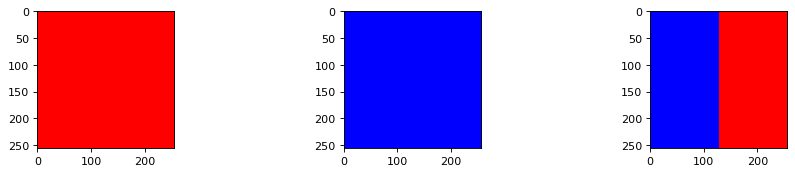

1.jpg                             2.jpg                             3.jpg                             
- red mean           255.00       - red mean             0.00       - red mean           127.50       
- green mean           0.00       - green mean           0.00       - green mean           0.00       
- blue mean            0.00       - blue mean          255.00       - blue mean          127.50       


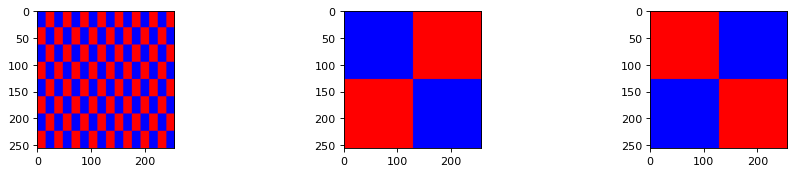

4.jpg                             5.jpg                             6.jpg                             
- red mean           127.50       - red mean           127.50       - red mean           127.50       
- green mean           0.00       - green mean           0.00       - green mean           0.00       
- blue mean          127.50       - blue mean          127.50       - blue mean          127.50       


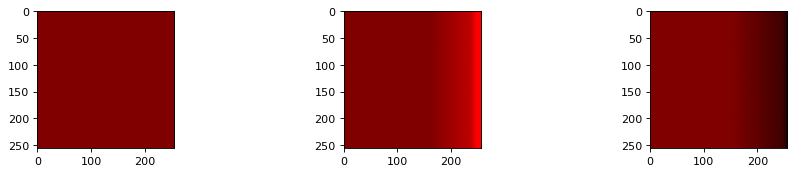

7.jpg                             8.jpg                             9.jpg                             
- red mean           128.00       - red mean           146.12       - red mean           112.66       
- green mean           0.00       - green mean           0.09       - green mean           0.09       
- blue mean            0.00       - blue mean            0.05       - blue mean            0.11       


In [4]:
featuresNames_MeanColors = ["red mean", "green mean", "blue mean"]

# TODO: DONE
def featuresExtractor_MeanColors(image):
    values = [
        np.mean(image[:,:,0]),
        np.mean(image[:,:,1]),
        np.mean(image[:,:,2])
    ]
    return values
    
e1 = Exercise("exercise1/intro/", featuresNames_MeanColors, featuresExtractor_MeanColors)
e1.display(scale = 1.0)

# ANSWERS:

# 1. Both images are completely different, when it comes to the values of R,G,B colours.
#    Image 1 is full of RED, while image 2 is full of BLUE.
#    That's why the means of red and blue on corresponding images are equal.

# 2. It's because these images contain the same number of red and blue pixels.
#    The only differences between them are the positions of pixels in chunked squares/rectangles.

# 3. For image 7, it can be seen, that the colour isn't bright.
#    It is caused by a smaller value of RED, which is why, the mean is 128.
#    Comparing image 8 with the image 7, it can be seen, that it is basically the same image, but brightened on the right side.
#    It leads to bigger mean of RED on a given image.
#    Comparing image 9 with the image 7 and 8, it is actually similar to image 7 but this time darkened on the same side.
#    The mean of RED has dropped.

1.2) The second color moment is a standard deviation. Complete the feturesExtractor_StdColors method so that it computes and returns a 3-element feature vector which containts the standard deviation of the red, green, and blue color (use np.std()). Run the script and analyse the results: <br><br>
   i) Why are all the feature vectors of the images 1.jpg-2.jpg the same (and equal to zero)?<br>
   ii) Why are all the feature vectors of the images 3.jpg-6.jpg the same? <br>

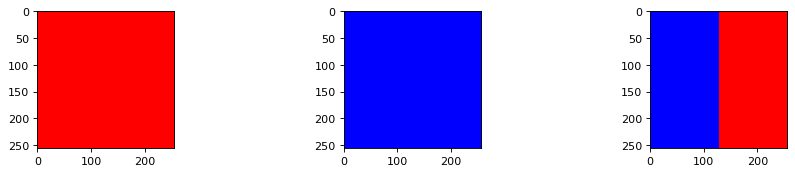

1.jpg                           2.jpg                           3.jpg                           
- red std             0.00      - red std             0.00      - red std           127.50      
- green std           0.00      - green std           0.00      - green std           0.00      
- blue std            0.00      - blue std            0.00      - blue std          127.50      


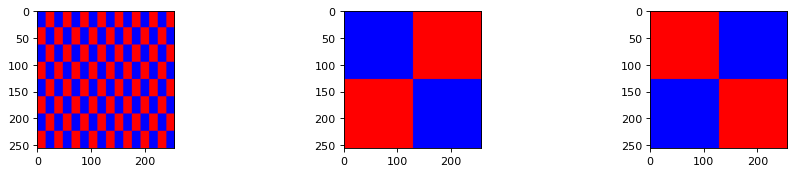

4.jpg                           5.jpg                           6.jpg                           
- red std           127.50      - red std           127.50      - red std           127.50      
- green std           0.00      - green std           0.00      - green std           0.00      
- blue std          127.50      - blue std          127.50      - blue std          127.50      


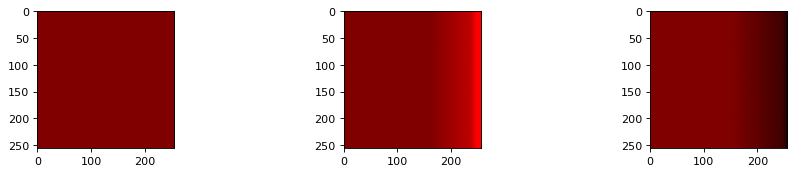

7.jpg                           8.jpg                           9.jpg                           
- red std             0.00      - red std            32.80      - red std            24.02      
- green std           0.00      - green std           0.29      - green std           0.29      
- blue std            0.00      - blue std            0.23      - blue std            0.32      


In [5]:
featuresNames_StdColors = ["red std", "green std", "blue std"]

# TODO: DONE
def featuresExtractor_StdColors(image):
    values = [
        np.std(image[:,:,0]),
        np.std(image[:,:,1]),
        np.std(image[:,:,2])
    ]
    return values
    
e1 = Exercise("exercise1/intro/", featuresNames_StdColors, featuresExtractor_StdColors)
e1.display(scale = 1.0)

# ANSWERS:

# 1. It is because there are no differences of colours in the image.
#    Both images are plain, fully filled with one consistent colour.
#    Thus, there is no deviation of colours.

# 2. There are only two colours on these images, both cover the same area.
#    So, the value of standard deviation is in half between 0 and 255.

1.3) The third color moment is a skeweness. The skeweness measures how asymmetric is the distribution (positive value = the right tail of the distribution is longer; negative value = the left tail of the distribution is longer).  Complete the feturesExtractor_SkewColors method so that it computes and returns a 3-element feature vector containing skeweness of the red, green, and blue color (use skew() + you must transform numpy array to 1-D array; use .ravel() ). Run the script and analyse the results: <br>
    i) Why are all the feature vectors of images 1.jpg-6.jpg the same (and all the values equal to zero)?<br>
   ii) Why is the skeweness of the distribution of the red color in image 8.jpg positive but in image 9.jpg is negative? <br>

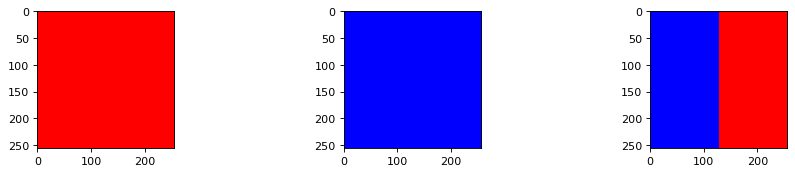

1.jpg                             2.jpg                             3.jpg                             
- red skew             0.00       - red skew             0.00       - red skew             0.00       
- green skew           0.00       - green skew           0.00       - green skew           0.00       
- blue skew            0.00       - blue skew            0.00       - blue skew            0.00       


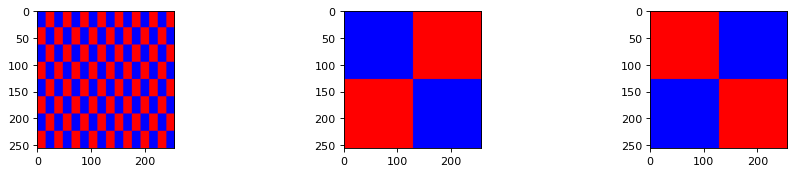

4.jpg                             5.jpg                             6.jpg                             
- red skew             0.00       - red skew             0.00       - red skew             0.00       
- green skew           0.00       - green skew           0.00       - green skew           0.00       
- blue skew            0.00       - blue skew            0.00       - blue skew            0.00       


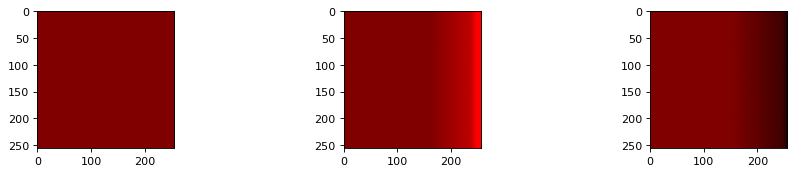

7.jpg                             8.jpg                             9.jpg                             
- red skew             0.00       - red skew             2.06       - red skew            -1.57       
- green skew           0.00       - green skew           3.13       - green skew           2.98       
- blue skew            0.00       - blue skew            4.02       - blue skew            2.62       


In [6]:
featuresNames_SkewColors = ["red skew", "green skew", "blue skew"]

# TODO: DONE
def featuresExtractor_SkewColors(image):
    values = [
        skew(image[:,:,0].ravel()),
        skew(image[:,:,1].ravel()),
        skew(image[:,:,2].ravel())
    ]
    return values
    
e1 = Exercise("exercise1/intro/", featuresNames_SkewColors, featuresExtractor_SkewColors)
e1.display(scale = 1.0)

# ANSWERS:

# 1. These images are plain and don't have any differences of the particular colours hues.
#    Thus, the images are symmetric, which gives skewness equal to 0.

# 2. Image 8 presents a situation, where there are some pixels that are brighter than the mean colour for the image.
#    This leads to the positive skewness value.
#    Image 9 is an opposite situation, which results in negative skewness.

1.4) Run the below script. This example involves real pictures. Analyse the computed feature vectors (returned by featuresExtractor_MeanColor method). Can you justify the results?<br>
i) Consider the image b1_blue.jpg. Which color has the greatest mean value and which has the lowest? Compare it with the image b3_blue.jpg. Which color is the most dominant one now? Can you justify the difference between these feature vectors by comparing the pictures?<br>
ii) Why are the mean values of the feature vector of the image b6_dark.jpg very low, while they are very high for the b16_white.jpg? <br>
iii) Which of these pictures is "the most red" in your opinion? Look only at the pictures. Then, check the mean value of the red color of the chosen picture. Is it the greatest among all pictures?

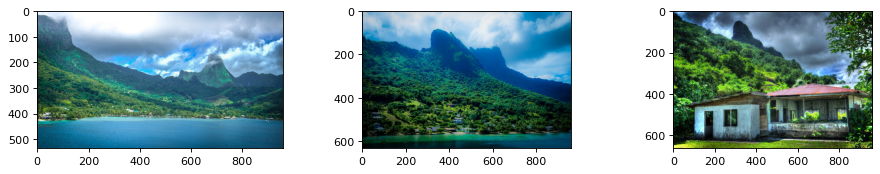

b1_blue.jpg                       b2_blue.jpg                       b3_blue.jpg                       
- red mean            91.29       - red mean            49.16       - red mean            75.92       
- green mean         140.78       - green mean         101.91       - green mean         104.11       
- blue mean          158.17       - blue mean          114.19       - blue mean           86.21       


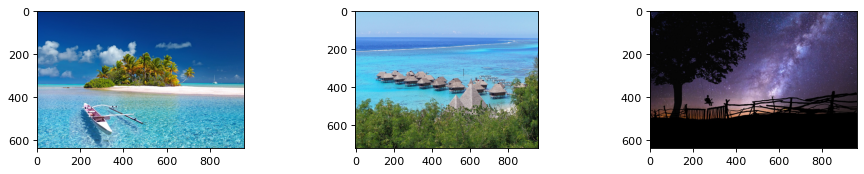

b4_blue.jpg                       b5_blue.jpg                       b6_dark.jpg                       
- red mean            72.89       - red mean           106.24       - red mean            45.40       
- green mean         128.36       - green mean         151.43       - green mean          38.85       
- blue mean          163.10       - blue mean          161.59       - blue mean           57.53       


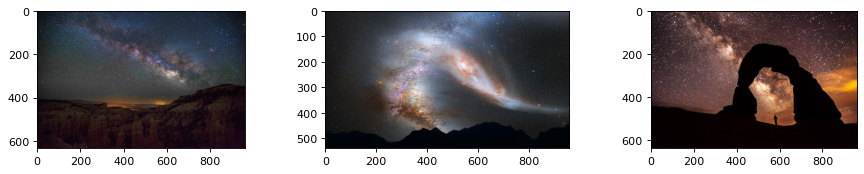

b7_night.jpg                      b8_night.jpg                      b9_night.jpg                      
- red mean            47.57       - red mean            66.40       - red mean            66.72       
- green mean          44.92       - green mean          66.53       - green mean          42.90       
- blue mean           51.92       - blue mean           72.24       - blue mean           37.88       


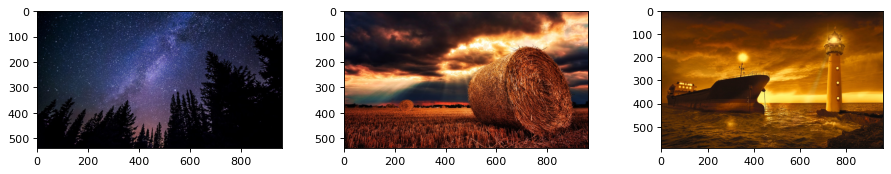

b10_night.jpg                       b11_red.jpg                         b12_red.jpg                         
- red mean             29.84        - red mean            109.32        - red mean            121.54        
- green mean           33.08        - green mean           63.53        - green mean           69.92        
- blue mean            55.91        - blue mean            45.21        - blue mean            12.02        


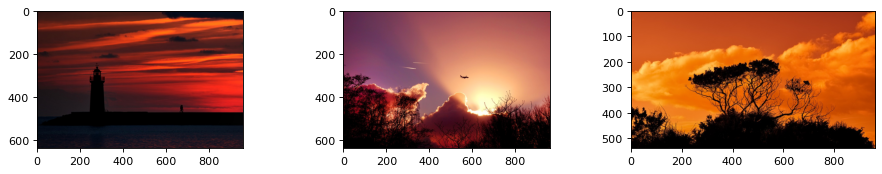

b13_red.jpg                       b14_red.jpg                       b15_red.jpg                       
- red mean            86.68       - red mean           138.77       - red mean           164.93       
- green mean          28.51       - green mean          79.15       - green mean          75.44       
- blue mean           24.68       - blue mean           76.32       - blue mean           17.73       


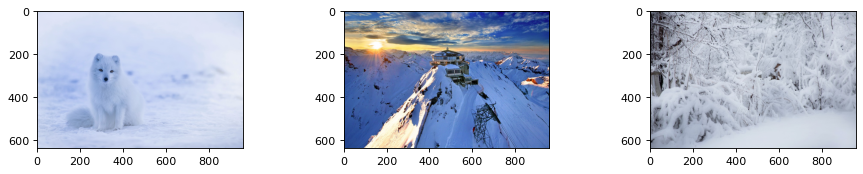

b16_white.jpg                       b17_white.jpg                       b18_white.jpg                       
- red mean            198.58        - red mean            106.62        - red mean            177.67        
- green mean          210.60        - green mean          124.15        - green mean          184.47        
- blue mean           238.11        - blue mean           162.22        - blue mean           197.93        


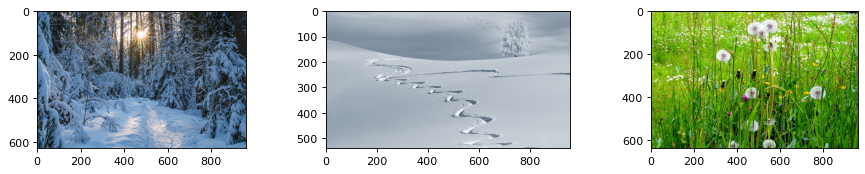

b19_white.jpg                       b20_white.jpg                       b21_green.jpg                       
- red mean             90.34        - red mean            171.43        - red mean            104.59        
- green mean          109.64        - green mean          181.99        - green mean          150.12        
- blue mean           130.00        - blue mean           192.86        - blue mean            39.56        


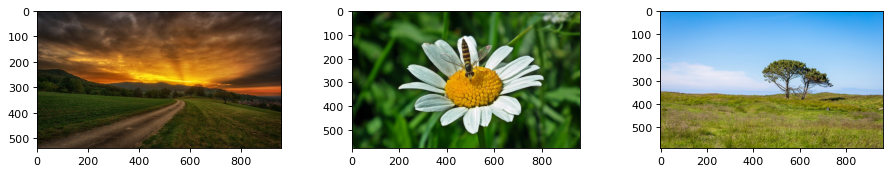

b22_green.jpg                       b23_green.jpg                       b24_green.jpg                       
- red mean             89.22        - red mean             73.10        - red mean            131.89        
- green mean           65.61        - green mean          101.08        - green mean          164.07        
- blue mean            29.21        - blue mean            50.68        - blue mean           157.92        


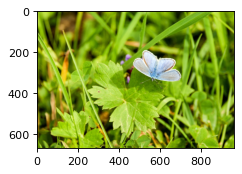

b25_green.jpg                       
- red mean            125.24        
- green mean          153.94        
- blue mean            31.46        


In [7]:
e1 = Exercise("exercise1/base/", featuresNames_MeanColors, featuresExtractor_MeanColors)
e1.display(scale = 1.0)

# ANSWERS:

# 1. The greatest mean value is a blue mean, while the lowest is for red. 
#    Comparing it with image b3_blue.jpg, these values are much lower and green mean is the dominant one.
#    It can be seen, that the first image is technically brighter (contains bigger values on each RGB channel),
#    while the second image is darker, more contrasting (lower values on each RGB channel).
#    Moreover, the first image contains more blue colour than the second image, which contains more green.

# 2. First image is very dark (lower values on each RGB channel), while the other one is extremely bright (higher values).

# 3. It depends on the definition.
#    When it comes to choose a picture, where the difference between red colour and the other ones is the biggest,
#    the first-sight choice would be somewhere between b11 and b15.
#    However, we should remember, that these images are rather dark which may lead to lower values of red colour,
#    than the bright images (expecially those, that are nearly totally white).
#    Given this observation, the second choice would probably go to b16, b18 or b20.
#    When it comes to the means, we can see, that the biggest value goes for image b16.

1.5) Now, it is time to build a simple seach engine for finding images. Your task is to complete the cosineSimilarity method which measures similarity between the two provided feature vectors. The greater is the returned value, the greater is the similarity. As the name of the method suggests, use a cosine similarity which is the cosine of the angle between the two vectors. You can use the spatial.distance.cosine() method. However, it returns a distance (the smaller value the better), not a similarity (the greater value the better). You have to handle this issue. Then, run the script. <br><br>
Firstly, the method searchForImage loads and displays the selected query image (q1_red.jpg), and derives its feature vector (featuresExtractor_MeanColor is used to extract feature vectors). Then, images from "exercise1/base" folder are displayed in the order of similarity to the query image. Do you agree with the ranking? Why? Why not? Why is b9_night.jpg ranked better than b15_red.jpg?

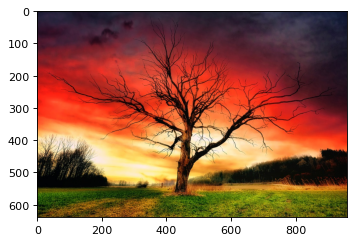

q1_red.jpg
- red mean           137.43       
- green mean          74.65       
- blue mean           48.20       


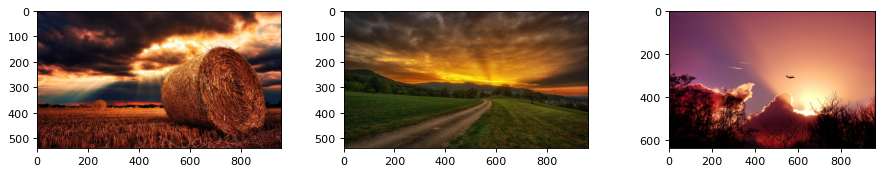

b11_red.jpg                         b22_green.jpg                       b14_red.jpg                         
Similarity              1.00        Similarity              0.99        Similarity              0.99        
- red mean            109.32        - red mean             89.22        - red mean            138.77        
- green mean           63.53        - green mean           65.61        - green mean           79.15        
- blue mean            45.21        - blue mean            29.21        - blue mean            76.32        


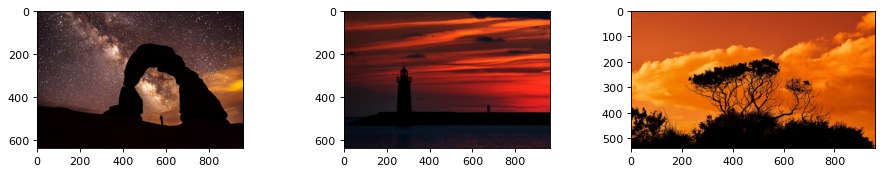

b9_night.jpg                      b13_red.jpg                       b15_red.jpg                       
Similarity             0.99       Similarity             0.98       Similarity             0.98       
- red mean            66.72       - red mean            86.68       - red mean           164.93       
- green mean          42.90       - green mean          28.51       - green mean          75.44       
- blue mean           37.88       - blue mean           24.68       - blue mean           17.73       


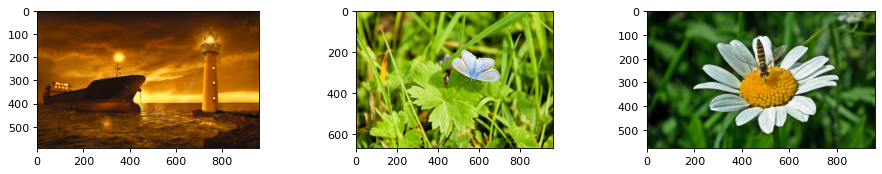

b12_red.jpg                         b25_green.jpg                       b23_green.jpg                       
Similarity              0.98        Similarity              0.92        Similarity              0.91        
- red mean            121.54        - red mean            125.24        - red mean             73.10        
- green mean           69.92        - green mean          153.94        - green mean          101.08        
- blue mean            12.02        - blue mean            31.46        - blue mean            50.68        


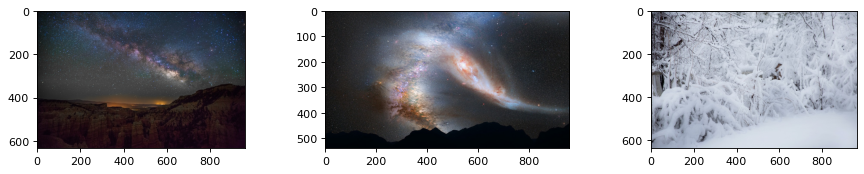

b7_night.jpg                        b8_night.jpg                        b18_white.jpg                       
Similarity              0.91        Similarity              0.91        Similarity              0.90        
- red mean             47.57        - red mean             66.40        - red mean            177.67        
- green mean           44.92        - green mean           66.53        - green mean          184.47        
- blue mean            51.92        - blue mean            72.24        - blue mean           197.93        


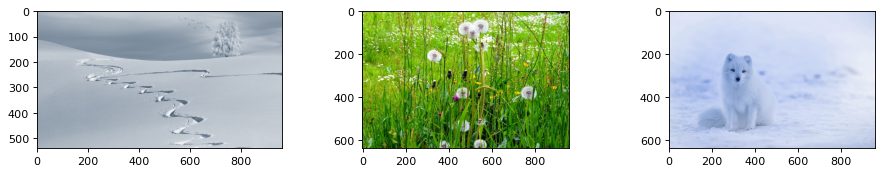

b20_white.jpg                       b21_green.jpg                       b16_white.jpg                       
Similarity              0.90        Similarity              0.90        Similarity              0.89        
- red mean            171.43        - red mean            104.59        - red mean            198.58        
- green mean          181.99        - green mean          150.12        - green mean          210.60        
- blue mean           192.86        - blue mean            39.56        - blue mean           238.11        


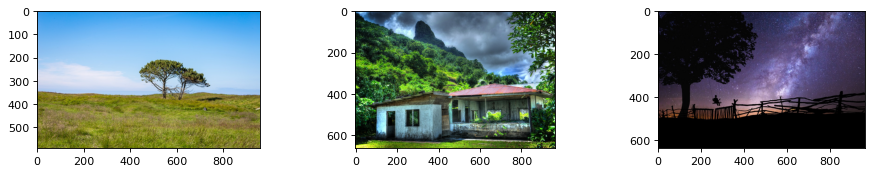

b24_green.jpg                       b3_blue.jpg                         b6_dark.jpg                         
Similarity              0.88        Similarity              0.88        Similarity              0.88        
- red mean            131.89        - red mean             75.92        - red mean             45.40        
- green mean          164.07        - green mean          104.11        - green mean           38.85        
- blue mean           157.92        - blue mean            86.21        - blue mean            57.53        


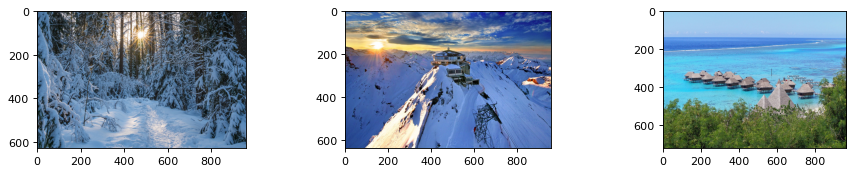

b19_white.jpg                       b17_white.jpg                       b5_blue.jpg                         
Similarity              0.85        Similarity              0.84        Similarity              0.84        
- red mean             90.34        - red mean            106.62        - red mean            106.24        
- green mean          109.64        - green mean          124.15        - green mean          151.43        
- blue mean           130.00        - blue mean           162.22        - blue mean           161.59        


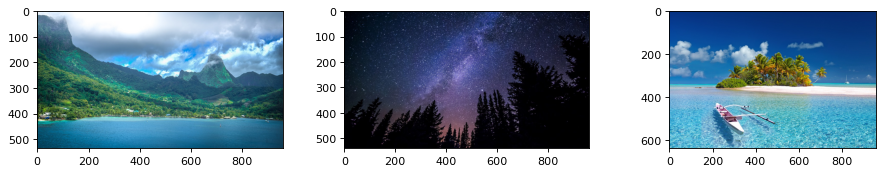

b1_blue.jpg                         b10_night.jpg                       b4_blue.jpg                         
Similarity              0.81        Similarity              0.79        Similarity              0.76        
- red mean             91.29        - red mean             29.84        - red mean             72.89        
- green mean          140.78        - green mean           33.08        - green mean          128.36        
- blue mean           158.17        - blue mean            55.91        - blue mean           163.10        


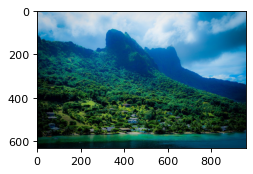

b2_blue.jpg                       
Similarity             0.76       
- red mean            49.16       
- green mean         101.91       
- blue mean          114.19       


In [8]:
# TODO: DONE
def cosineSimilarity(featuresQuery, featuresImage):
    return 1.0 - spatial.distance.cosine(featuresQuery, featuresImage)

e1 = Exercise("exercise1/base/", featuresNames_MeanColors, featuresExtractor_MeanColors)
e1.searchForImage("exercise1/query/", "q1_red.jpg", cosineSimilarity)

# ANSWERS:

# I agree with the ranking. When we browse through the following images, from ranked as most similar, to the least one,
# it can be seen, that the images become to go gradually more green and blue, while losing the red colour.
# But there are also "eye-trap" images, e.g. image b9 which looks rather less similar to a given image, than image b15.
# It is because of the darkness, which makes us see less details, but in fact, the similarity is preserved.
# The image b9 contains more various colours (like query image q1),
# while the image b15 contains much more red colour, and lacks blue.

1.6) Search for the most similar images to q2_green.jpg. Verify the results.

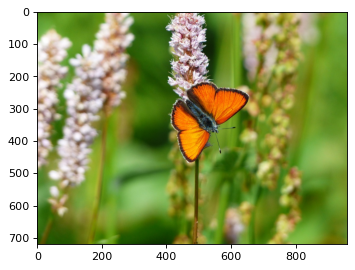

q2_green.jpg
- red mean           127.21       
- green mean         142.08       
- blue mean           64.78       


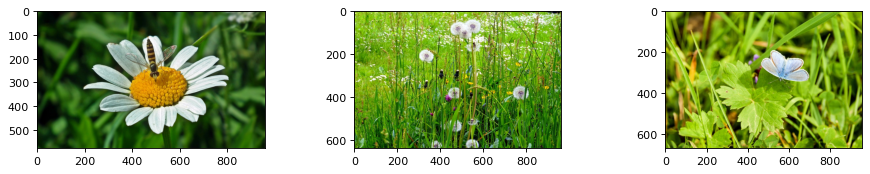

b23_green.jpg                       b21_green.jpg                       b25_green.jpg                       
Similarity              0.99        Similarity              0.99        Similarity              0.98        
- red mean             73.10        - red mean            104.59        - red mean            125.24        
- green mean          101.08        - green mean          150.12        - green mean          153.94        
- blue mean            50.68        - blue mean            39.56        - blue mean            31.46        


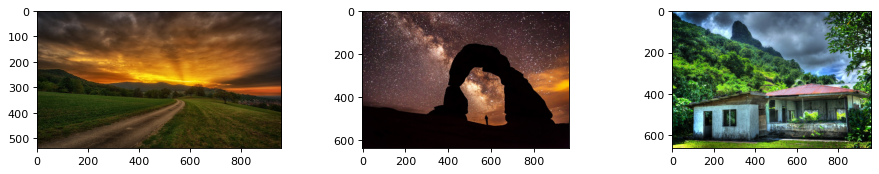

b22_green.jpg                       b9_night.jpg                        b3_blue.jpg                         
Similarity              0.98        Similarity              0.96        Similarity              0.96        
- red mean             89.22        - red mean             66.72        - red mean             75.92        
- green mean           65.61        - green mean           42.90        - green mean          104.11        
- blue mean            29.21        - blue mean            37.88        - blue mean            86.21        


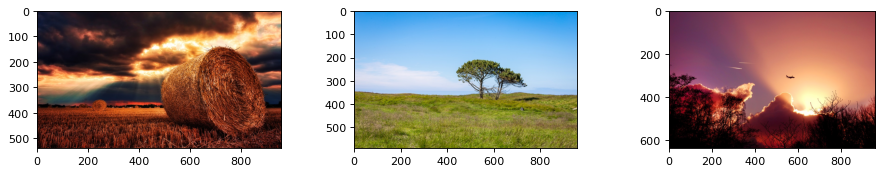

b11_red.jpg                         b24_green.jpg                       b14_red.jpg                         
Similarity              0.96        Similarity              0.95        Similarity              0.95        
- red mean            109.32        - red mean            131.89        - red mean            138.77        
- green mean           63.53        - green mean          164.07        - green mean           79.15        
- blue mean            45.21        - blue mean           157.92        - blue mean            76.32        


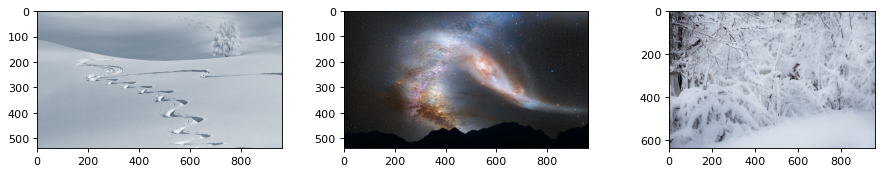

b20_white.jpg                       b8_night.jpg                        b18_white.jpg                       
Similarity              0.95        Similarity              0.95        Similarity              0.95        
- red mean            171.43        - red mean             66.40        - red mean            177.67        
- green mean          181.99        - green mean           66.53        - green mean          184.47        
- blue mean           192.86        - blue mean            72.24        - blue mean           197.93        


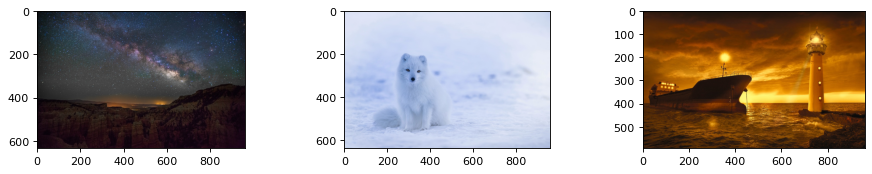

b7_night.jpg                        b16_white.jpg                       b12_red.jpg                         
Similarity              0.94        Similarity              0.94        Similarity              0.92        
- red mean             47.57        - red mean            198.58        - red mean            121.54        
- green mean           44.92        - green mean          210.60        - green mean           69.92        
- blue mean            51.92        - blue mean           238.11        - blue mean            12.02        


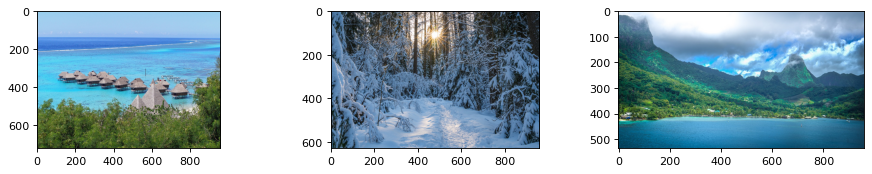

b5_blue.jpg                         b19_white.jpg                       b1_blue.jpg                         
Similarity              0.92        Similarity              0.92        Similarity              0.90        
- red mean            106.24        - red mean             90.34        - red mean             91.29        
- green mean          151.43        - green mean          109.64        - green mean          140.78        
- blue mean           161.59        - blue mean           130.00        - blue mean           158.17        


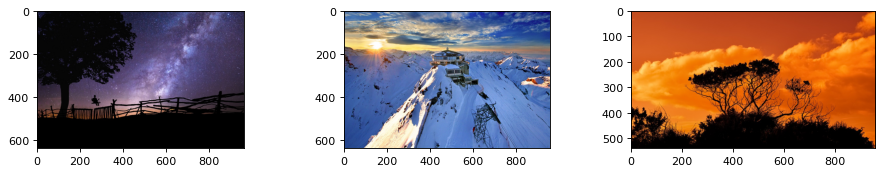

b6_dark.jpg                         b17_white.jpg                       b15_red.jpg                         
Similarity              0.90        Similarity              0.90        Similarity              0.89        
- red mean             45.40        - red mean            106.62        - red mean            164.93        
- green mean           38.85        - green mean          124.15        - green mean           75.44        
- blue mean            57.53        - blue mean           162.22        - blue mean            17.73        


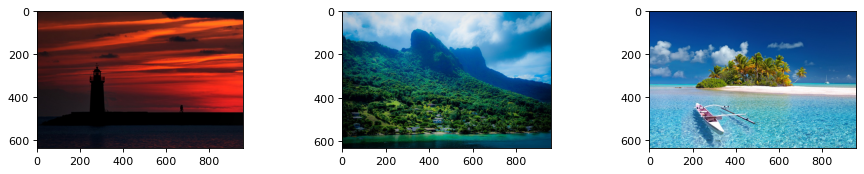

b13_red.jpg                       b2_blue.jpg                       b4_blue.jpg                       
Similarity             0.88       Similarity             0.87       Similarity             0.86       
- red mean            86.68       - red mean            49.16       - red mean            72.89       
- green mean          28.51       - green mean         101.91       - green mean         128.36       
- blue mean           24.68       - blue mean          114.19       - blue mean          163.10       


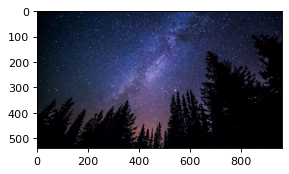

b10_night.jpg                       
Similarity              0.84        
- red mean             29.84        
- green mean           33.08        
- blue mean            55.91        


In [9]:
e1.searchForImage("exercise1/query/", "q2_green.jpg", cosineSimilarity)

# ANSWERS:
# The ranking looks fine, but there are images, which actually confuse human eye perception and make us think,
# that these images are more similar, e.g. image b5, b1 or b2 than others (like b12 or 16).

1.7) Search for the most similar images to q3_blue.jpg. Verify the results.

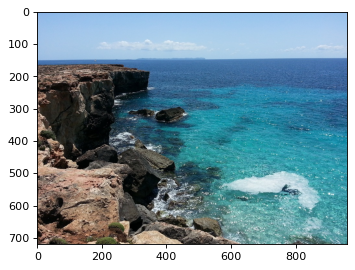

q3_blue.jpg
- red mean            93.09       
- green mean         128.93       
- blue mean          143.78       


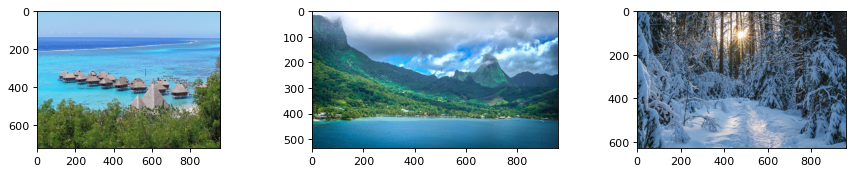

b5_blue.jpg                         b1_blue.jpg                         b19_white.jpg                       
Similarity              1.00        Similarity              1.00        Similarity              1.00        
- red mean            106.24        - red mean             91.29        - red mean             90.34        
- green mean          151.43        - green mean          140.78        - green mean          109.64        
- blue mean           161.59        - blue mean           158.17        - blue mean           130.00        


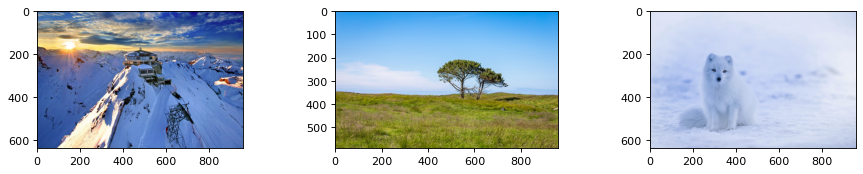

b17_white.jpg                       b24_green.jpg                       b16_white.jpg                       
Similarity              1.00        Similarity              1.00        Similarity              0.99        
- red mean            106.62        - red mean            131.89        - red mean            198.58        
- green mean          124.15        - green mean          164.07        - green mean          210.60        
- blue mean           162.22        - blue mean           157.92        - blue mean           238.11        


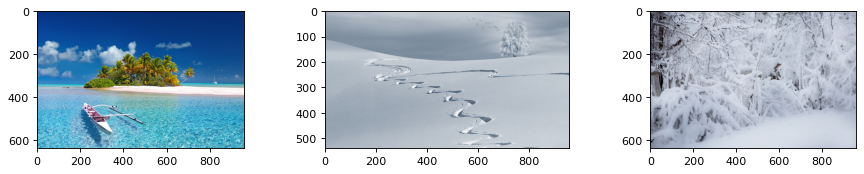

b4_blue.jpg                         b20_white.jpg                       b18_white.jpg                       
Similarity              0.99        Similarity              0.99        Similarity              0.99        
- red mean             72.89        - red mean            171.43        - red mean            177.67        
- green mean          128.36        - green mean          181.99        - green mean          184.47        
- blue mean           163.10        - blue mean           192.86        - blue mean           197.93        


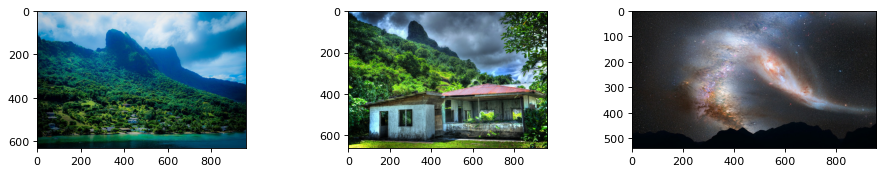

b2_blue.jpg                       b3_blue.jpg                       b8_night.jpg                      
Similarity             0.99       Similarity             0.99       Similarity             0.99       
- red mean            49.16       - red mean            75.92       - red mean            66.40       
- green mean         101.91       - green mean         104.11       - green mean          66.53       
- blue mean          114.19       - blue mean           86.21       - blue mean           72.24       


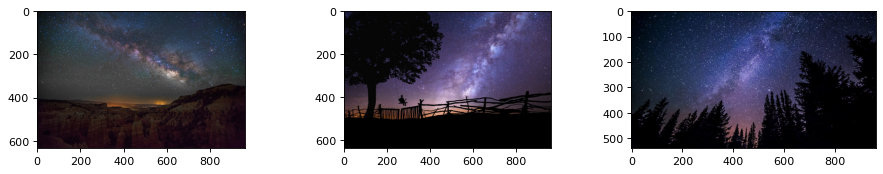

b7_night.jpg                        b6_dark.jpg                         b10_night.jpg                       
Similarity              0.99        Similarity              0.98        Similarity              0.98        
- red mean             47.57        - red mean             45.40        - red mean             29.84        
- green mean           44.92        - green mean           38.85        - green mean           33.08        
- blue mean            51.92        - blue mean            57.53        - blue mean            55.91        


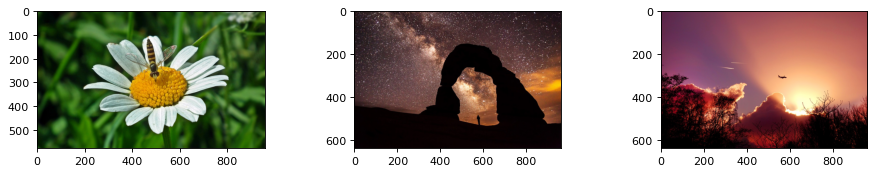

b23_green.jpg                       b9_night.jpg                        b14_red.jpg                         
Similarity              0.94        Similarity              0.91        Similarity              0.90        
- red mean             73.10        - red mean             66.72        - red mean            138.77        
- green mean          101.08        - green mean           42.90        - green mean           79.15        
- blue mean            50.68        - blue mean            37.88        - blue mean            76.32        


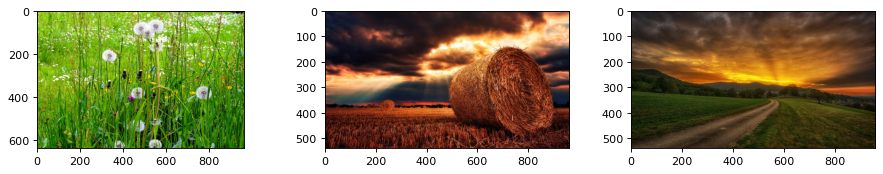

b21_green.jpg                       b11_red.jpg                         b22_green.jpg                       
Similarity              0.87        Similarity              0.86        Similarity              0.85        
- red mean            104.59        - red mean            109.32        - red mean             89.22        
- green mean          150.12        - green mean           63.53        - green mean           65.61        
- blue mean            39.56        - blue mean            45.21        - blue mean            29.21        


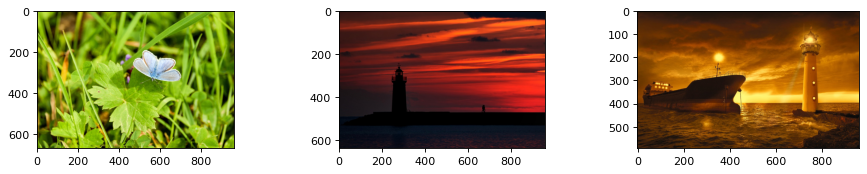

b25_green.jpg                       b13_red.jpg                         b12_red.jpg                         
Similarity              0.84        Similarity              0.75        Similarity              0.73        
- red mean            125.24        - red mean             86.68        - red mean            121.54        
- green mean          153.94        - green mean           28.51        - green mean           69.92        
- blue mean            31.46        - blue mean            24.68        - blue mean            12.02        


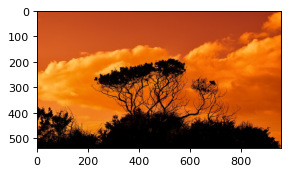

b15_red.jpg                       
Similarity             0.71       
- red mean           164.93       
- green mean          75.44       
- blue mean           17.73       


In [10]:
e1.searchForImage("exercise1/query/", "q3_blue.jpg", cosineSimilarity)

# ANSWERS:
# The rank looks good as we take a peek on it for the first time. Colours are similar. But we can see that there
# are some images that can be unwanted by user. Every image with "_white" suffix doesn't seem to be similar to 
# our q3_blue. So if we think about colour values the rank is good but if we are looking at these images
# as user it can be pretty confusing.

1.8) Search for the most similar images to q4_white.jpg. Verify the results.

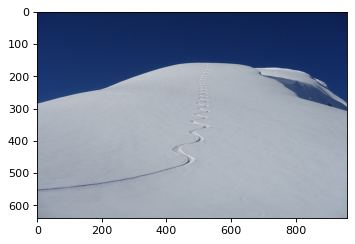

q4_white.jpg
- red mean           120.71       
- green mean         133.53       
- blue mean          157.62       


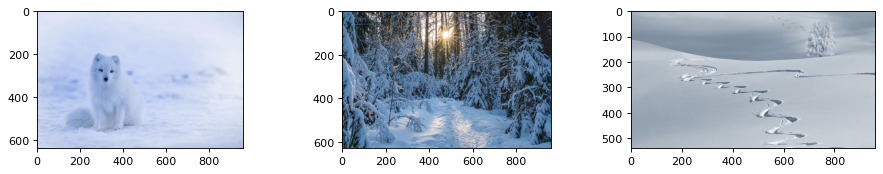

b16_white.jpg                       b19_white.jpg                       b20_white.jpg                       
Similarity              1.00        Similarity              1.00        Similarity              1.00        
- red mean            198.58        - red mean             90.34        - red mean            171.43        
- green mean          210.60        - green mean          109.64        - green mean          181.99        
- blue mean           238.11        - blue mean           130.00        - blue mean           192.86        


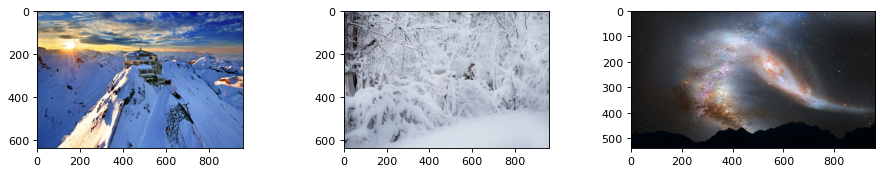

b17_white.jpg                       b18_white.jpg                       b8_night.jpg                        
Similarity              1.00        Similarity              1.00        Similarity              1.00        
- red mean            106.62        - red mean            177.67        - red mean             66.40        
- green mean          124.15        - green mean          184.47        - green mean           66.53        
- blue mean           162.22        - blue mean           197.93        - blue mean            72.24        


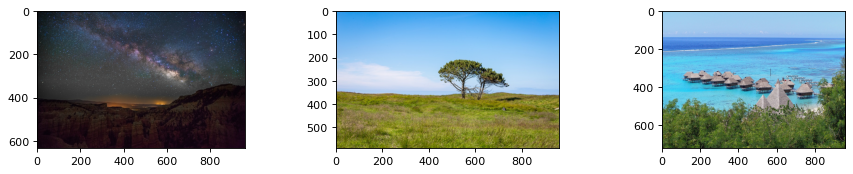

b7_night.jpg                        b24_green.jpg                       b5_blue.jpg                         
Similarity              1.00        Similarity              1.00        Similarity              1.00        
- red mean             47.57        - red mean            131.89        - red mean            106.24        
- green mean           44.92        - green mean          164.07        - green mean          151.43        
- blue mean            51.92        - blue mean           157.92        - blue mean           161.59        


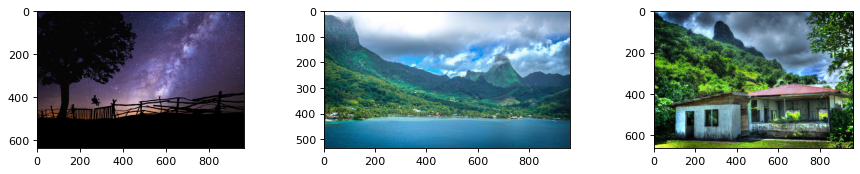

b6_dark.jpg                       b1_blue.jpg                       b3_blue.jpg                       
Similarity             0.99       Similarity             0.99       Similarity             0.99       
- red mean            45.40       - red mean            91.29       - red mean            75.92       
- green mean          38.85       - green mean         140.78       - green mean         104.11       
- blue mean           57.53       - blue mean          158.17       - blue mean           86.21       


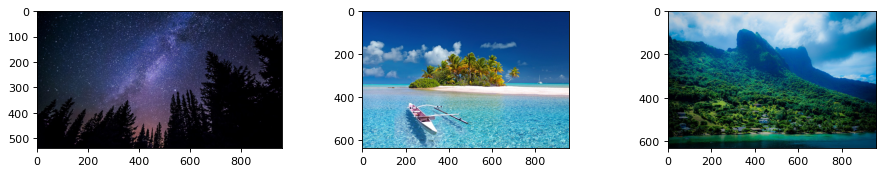

b10_night.jpg                       b4_blue.jpg                         b2_blue.jpg                         
Similarity              0.98        Similarity              0.98        Similarity              0.98        
- red mean             29.84        - red mean             72.89        - red mean             49.16        
- green mean           33.08        - green mean          128.36        - green mean          101.91        
- blue mean            55.91        - blue mean           163.10        - blue mean           114.19        


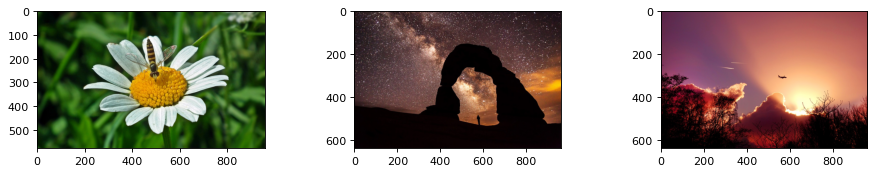

b23_green.jpg                       b9_night.jpg                        b14_red.jpg                         
Similarity              0.94        Similarity              0.94        Similarity              0.93        
- red mean             73.10        - red mean             66.72        - red mean            138.77        
- green mean          101.08        - green mean           42.90        - green mean           79.15        
- blue mean            50.68        - blue mean            37.88        - blue mean            76.32        


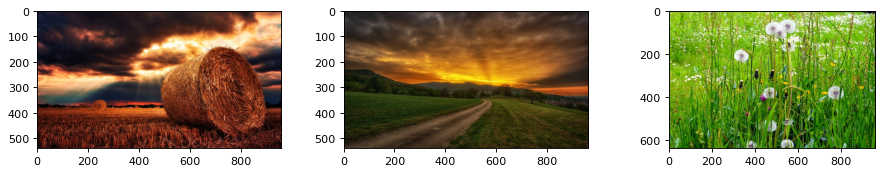

b11_red.jpg                         b22_green.jpg                       b21_green.jpg                       
Similarity              0.90        Similarity              0.88        Similarity              0.87        
- red mean            109.32        - red mean             89.22        - red mean            104.59        
- green mean           63.53        - green mean           65.61        - green mean          150.12        
- blue mean            45.21        - blue mean            29.21        - blue mean            39.56        


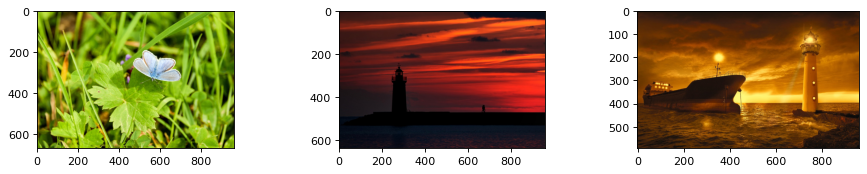

b25_green.jpg                       b13_red.jpg                         b12_red.jpg                         
Similarity              0.85        Similarity              0.80        Similarity              0.77        
- red mean            125.24        - red mean             86.68        - red mean            121.54        
- green mean          153.94        - green mean           28.51        - green mean           69.92        
- blue mean            31.46        - blue mean            24.68        - blue mean            12.02        


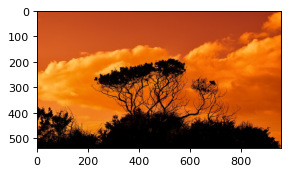

b15_red.jpg                       
Similarity             0.75       
- red mean           164.93       
- green mean          75.44       
- blue mean           17.73       


In [11]:
e1.searchForImage("exercise1/query/", "q4_white.jpg", cosineSimilarity)

# ANSWERS:
# For user this ranking can be pretty good. White pictures are on the top. But we should look at "Similarity" value.
# We can see that for b8_night and b7_night it's "1.0" which is pretty confusing.
# So I would disagree with this ranking. Algorithm analyzes only differences ratio between channel values.
# And as a result we have situation like here: dark images should be classified at the end, 
# but their ratio remains more similar, than e.g. b15 image so they are more "similar" to query image.

1.9) Search for the most similar images to q5_dark.jpg. Verify the results.

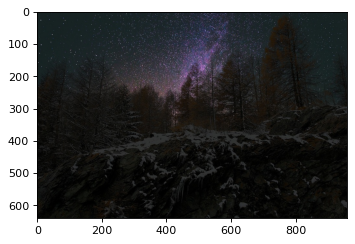

q5_dark.jpg
- red mean            24.89       
- green mean          25.89       
- blue mean           26.53       


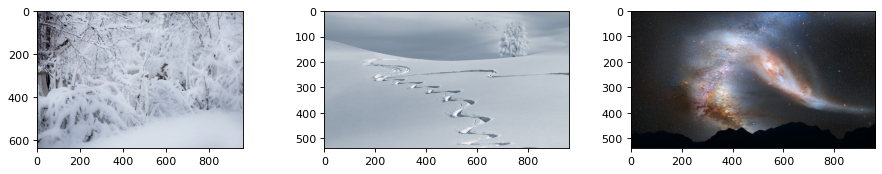

b18_white.jpg                       b20_white.jpg                       b8_night.jpg                        
Similarity              1.00        Similarity              1.00        Similarity              1.00        
- red mean            177.67        - red mean            171.43        - red mean             66.40        
- green mean          184.47        - green mean          181.99        - green mean           66.53        
- blue mean           197.93        - blue mean           192.86        - blue mean            72.24        


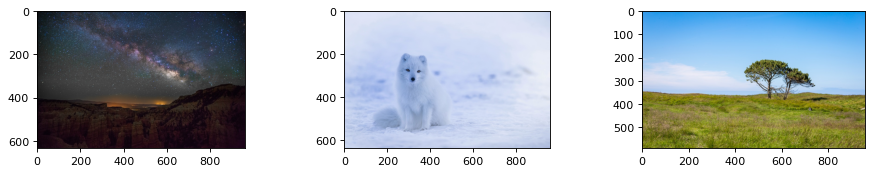

b7_night.jpg                        b16_white.jpg                       b24_green.jpg                       
Similarity              1.00        Similarity              1.00        Similarity              1.00        
- red mean             47.57        - red mean            198.58        - red mean            131.89        
- green mean           44.92        - green mean          210.60        - green mean          164.07        
- blue mean            51.92        - blue mean           238.11        - blue mean           157.92        


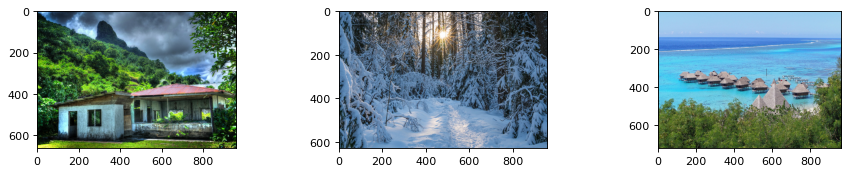

b3_blue.jpg                         b19_white.jpg                       b5_blue.jpg                         
Similarity              0.99        Similarity              0.99        Similarity              0.99        
- red mean             75.92        - red mean             90.34        - red mean            106.24        
- green mean          104.11        - green mean          109.64        - green mean          151.43        
- blue mean            86.21        - blue mean           130.00        - blue mean           161.59        


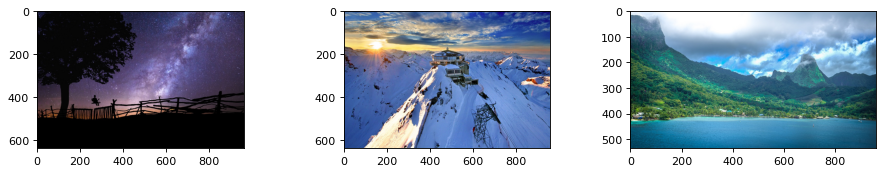

b6_dark.jpg                         b17_white.jpg                       b1_blue.jpg                         
Similarity              0.99        Similarity              0.99        Similarity              0.98        
- red mean             45.40        - red mean            106.62        - red mean             91.29        
- green mean           38.85        - green mean          124.15        - green mean          140.78        
- blue mean            57.53        - blue mean           162.22        - blue mean           158.17        


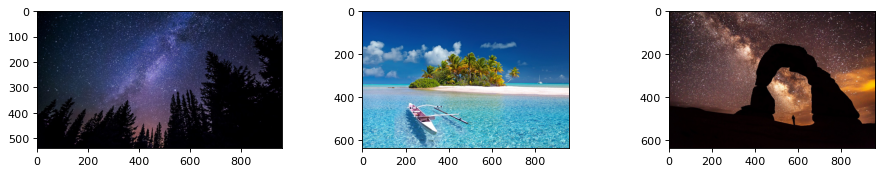

b10_night.jpg                       b4_blue.jpg                         b9_night.jpg                        
Similarity              0.97        Similarity              0.96        Similarity              0.96        
- red mean             29.84        - red mean             72.89        - red mean             66.72        
- green mean           33.08        - green mean          128.36        - green mean           42.90        
- blue mean            55.91        - blue mean           163.10        - blue mean            37.88        


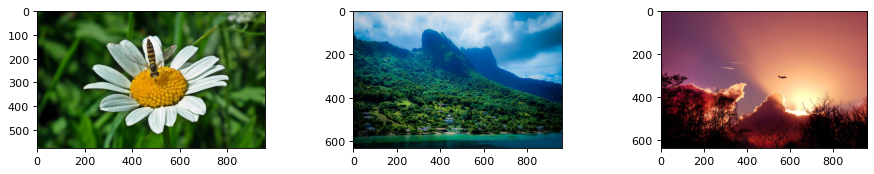

b23_green.jpg                       b2_blue.jpg                         b14_red.jpg                         
Similarity              0.96        Similarity              0.96        Similarity              0.95        
- red mean             73.10        - red mean             49.16        - red mean            138.77        
- green mean          101.08        - green mean          101.91        - green mean           79.15        
- blue mean            50.68        - blue mean           114.19        - blue mean            76.32        


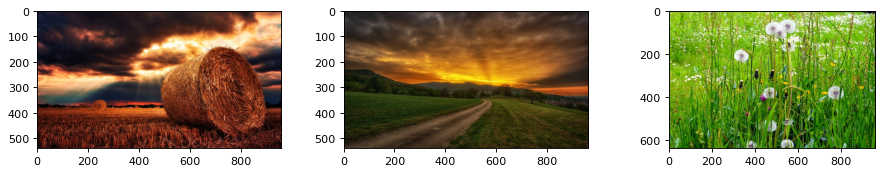

b11_red.jpg                         b22_green.jpg                       b21_green.jpg                       
Similarity              0.93        Similarity              0.92        Similarity              0.90        
- red mean            109.32        - red mean             89.22        - red mean            104.59        
- green mean           63.53        - green mean           65.61        - green mean          150.12        
- blue mean            45.21        - blue mean            29.21        - blue mean            39.56        


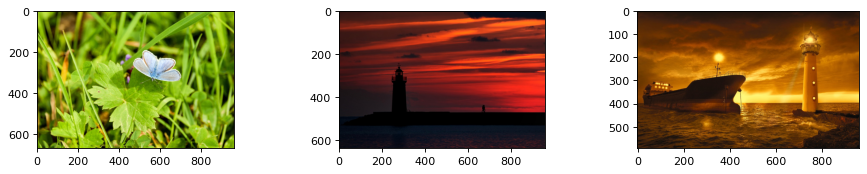

b25_green.jpg                       b13_red.jpg                         b12_red.jpg                         
Similarity              0.88        Similarity              0.84        Similarity              0.82        
- red mean            125.24        - red mean             86.68        - red mean            121.54        
- green mean          153.94        - green mean           28.51        - green mean           69.92        
- blue mean            31.46        - blue mean            24.68        - blue mean            12.02        


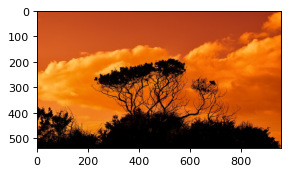

b15_red.jpg                       
Similarity             0.80       
- red mean           164.93       
- green mean          75.44       
- blue mean           17.73       


In [12]:
e1.searchForImage("exercise1/query/", "q5_dark.jpg", cosineSimilarity)

# ANSWERS:
# Obviously disagree with the ranking. The situation here is just identical to the previous one.
# We have very low values for query image and very high values for first two images in ranking, but they are similar
# to each other. That's why these two images are on the top of ranking, which is wrong.

1.10) You should find the results for the query image = q5_dark.jpg not satisfactory. What is the reason? <br>
Now, use another function of similarity. Use euclidean distance to compute similarity between the two feacture vectors. You can use spatial.distance.euclidean() method but remember that it returns a distance, not a similarity. 

In [13]:
# TODO: DONE
def euclideanSimilarity(featuresQuery, featuresImage):
    return 1/(1 + spatial.distance.euclidean(featuresQuery, featuresImage))

1.11) Search for the most similar images to q5_dark.jpg using euclideanSimilarity method. Do you find the results much better?

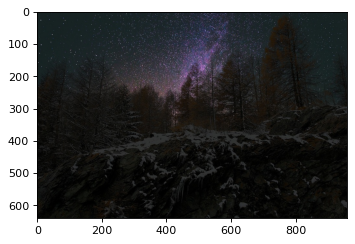

q5_dark.jpg
- red mean            24.89       
- green mean          25.89       
- blue mean           26.53       


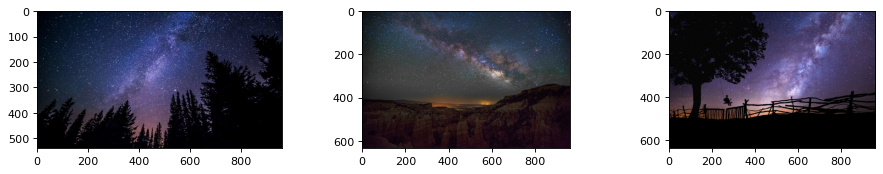

b10_night.jpg                       b7_night.jpg                        b6_dark.jpg                         
Similarity              0.03        Similarity              0.02        Similarity              0.02        
- red mean             29.84        - red mean             47.57        - red mean             45.40        
- green mean           33.08        - green mean           44.92        - green mean           38.85        
- blue mean            55.91        - blue mean            51.92        - blue mean            57.53        


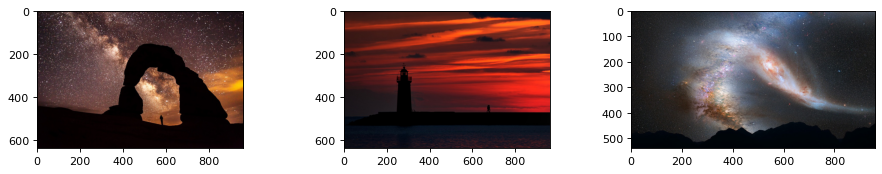

b9_night.jpg                      b13_red.jpg                       b8_night.jpg                      
Similarity             0.02       Similarity             0.02       Similarity             0.01       
- red mean            66.72       - red mean            86.68       - red mean            66.40       
- green mean          42.90       - green mean          28.51       - green mean          66.53       
- blue mean           37.88       - blue mean           24.68       - blue mean           72.24       


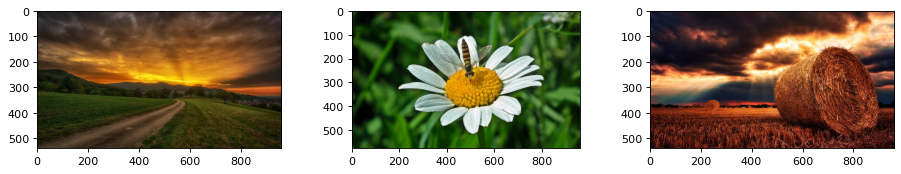

b22_green.jpg                       b23_green.jpg                       b11_red.jpg                         
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean             89.22        - red mean             73.10        - red mean            109.32        
- green mean           65.61        - green mean          101.08        - green mean           63.53        
- blue mean            29.21        - blue mean            50.68        - blue mean            45.21        


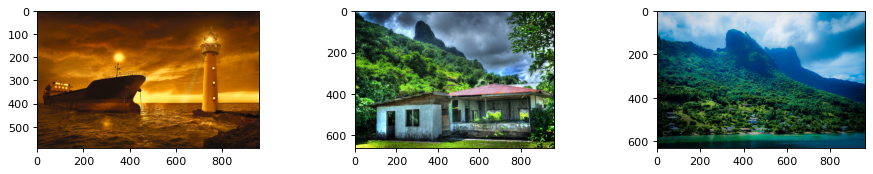

b12_red.jpg                       b3_blue.jpg                       b2_blue.jpg                       
Similarity             0.01       Similarity             0.01       Similarity             0.01       
- red mean           121.54       - red mean            75.92       - red mean            49.16       
- green mean          69.92       - green mean         104.11       - green mean         101.91       
- blue mean           12.02       - blue mean           86.21       - blue mean          114.19       


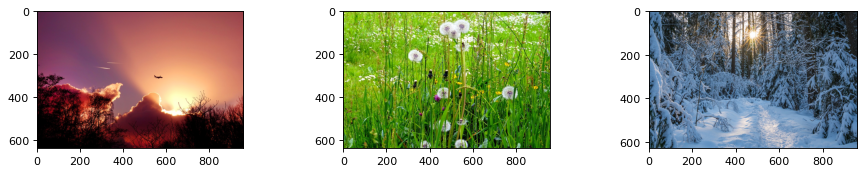

b14_red.jpg                         b21_green.jpg                       b19_white.jpg                       
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean            138.77        - red mean            104.59        - red mean             90.34        
- green mean           79.15        - green mean          150.12        - green mean          109.64        
- blue mean            76.32        - blue mean            39.56        - blue mean           130.00        


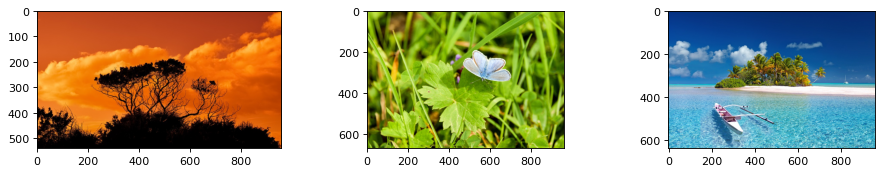

b15_red.jpg                         b25_green.jpg                       b4_blue.jpg                         
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean            164.93        - red mean            125.24        - red mean             72.89        
- green mean           75.44        - green mean          153.94        - green mean          128.36        
- blue mean            17.73        - blue mean            31.46        - blue mean           163.10        


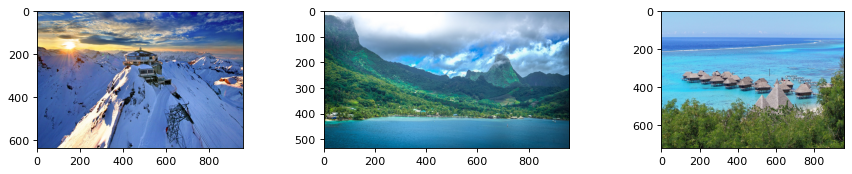

b17_white.jpg                       b1_blue.jpg                         b5_blue.jpg                         
Similarity              0.01        Similarity              0.01        Similarity              0.00        
- red mean            106.62        - red mean             91.29        - red mean            106.24        
- green mean          124.15        - green mean          140.78        - green mean          151.43        
- blue mean           162.22        - blue mean           158.17        - blue mean           161.59        


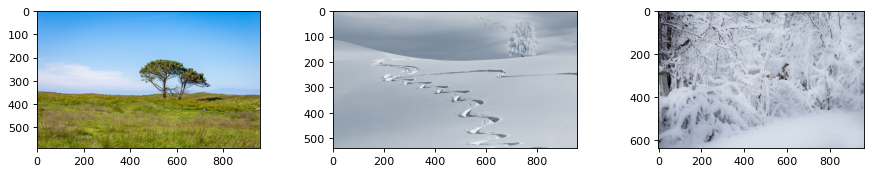

b24_green.jpg                       b20_white.jpg                       b18_white.jpg                       
Similarity              0.00        Similarity              0.00        Similarity              0.00        
- red mean            131.89        - red mean            171.43        - red mean            177.67        
- green mean          164.07        - green mean          181.99        - green mean          184.47        
- blue mean           157.92        - blue mean           192.86        - blue mean           197.93        


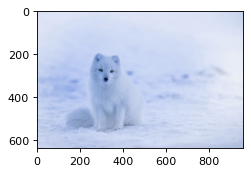

b16_white.jpg                       
Similarity              0.00        
- red mean            198.58        
- green mean          210.60        
- blue mean           238.11        


In [14]:
e1.searchForImage("exercise1/query/", "q5_dark.jpg", euclideanSimilarity)

# ANSWERS:
# Now the ranking looks much more satisfactory. Similarity is very low, but this is because we take Euclidean distance
# which doesn't have max 1.0 like cosine. Only very, very similar images have very high similarity. But as we can
# see, results comparing to previous are great for user.

1.12) Do the same for query image "q4_white.jpg". Why are the results not satisfactory?

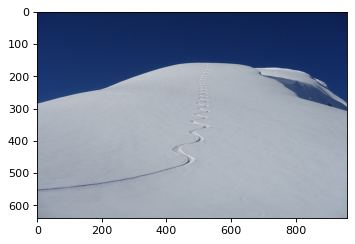

q4_white.jpg
- red mean           120.71       
- green mean         133.53       
- blue mean          157.62       


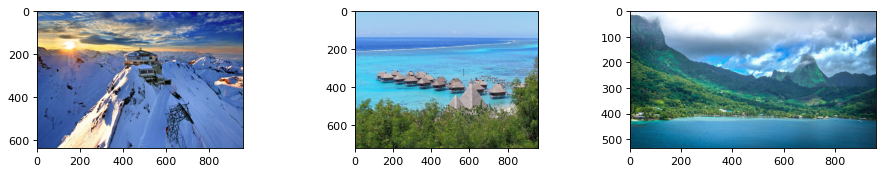

b17_white.jpg                       b5_blue.jpg                         b1_blue.jpg                         
Similarity              0.05        Similarity              0.04        Similarity              0.03        
- red mean            106.62        - red mean            106.24        - red mean             91.29        
- green mean          124.15        - green mean          151.43        - green mean          140.78        
- blue mean           162.22        - blue mean           161.59        - blue mean           158.17        


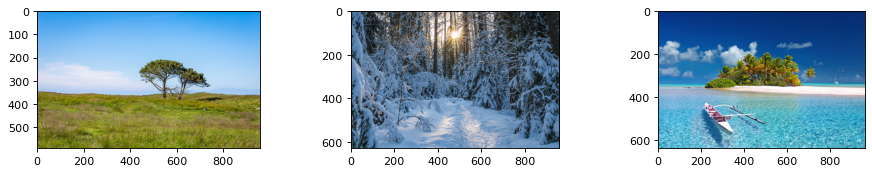

b24_green.jpg                       b19_white.jpg                       b4_blue.jpg                         
Similarity              0.03        Similarity              0.02        Similarity              0.02        
- red mean            131.89        - red mean             90.34        - red mean             72.89        
- green mean          164.07        - green mean          109.64        - green mean          128.36        
- blue mean           157.92        - blue mean           130.00        - blue mean           163.10        


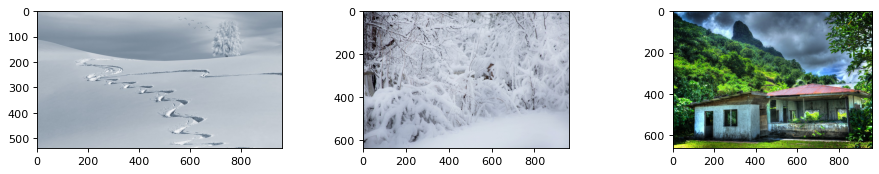

b20_white.jpg                       b18_white.jpg                       b3_blue.jpg                         
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean            171.43        - red mean            177.67        - red mean             75.92        
- green mean          181.99        - green mean          184.47        - green mean          104.11        
- blue mean           192.86        - blue mean           197.93        - blue mean            86.21        


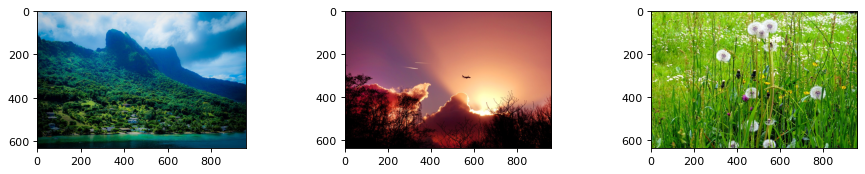

b2_blue.jpg                         b14_red.jpg                         b21_green.jpg                       
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean             49.16        - red mean            138.77        - red mean            104.59        
- green mean          101.91        - green mean           79.15        - green mean          150.12        
- blue mean           114.19        - blue mean            76.32        - blue mean            39.56        


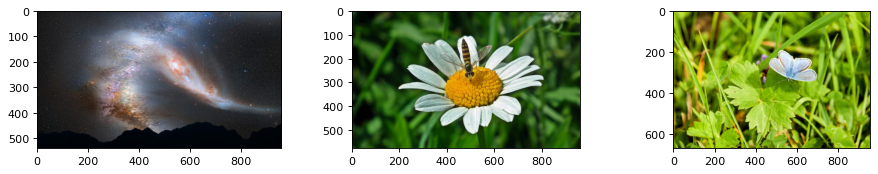

b8_night.jpg                        b23_green.jpg                       b25_green.jpg                       
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean             66.40        - red mean             73.10        - red mean            125.24        
- green mean           66.53        - green mean          101.08        - green mean          153.94        
- blue mean            72.24        - blue mean            50.68        - blue mean            31.46        


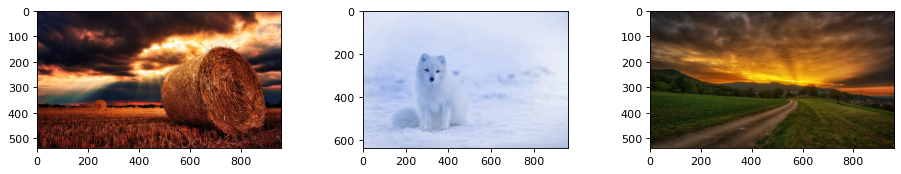

b11_red.jpg                         b16_white.jpg                       b22_green.jpg                       
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean            109.32        - red mean            198.58        - red mean             89.22        
- green mean           63.53        - green mean          210.60        - green mean           65.61        
- blue mean            45.21        - blue mean           238.11        - blue mean            29.21        


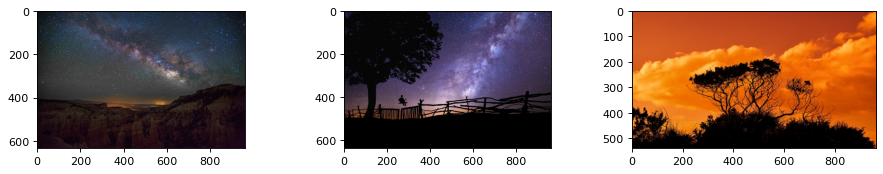

b7_night.jpg                      b6_dark.jpg                       b15_red.jpg                       
Similarity             0.01       Similarity             0.01       Similarity             0.01       
- red mean            47.57       - red mean            45.40       - red mean           164.93       
- green mean          44.92       - green mean          38.85       - green mean          75.44       
- blue mean           51.92       - blue mean           57.53       - blue mean           17.73       


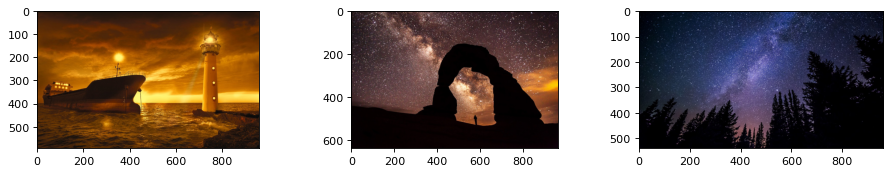

b12_red.jpg                         b9_night.jpg                        b10_night.jpg                       
Similarity              0.01        Similarity              0.01        Similarity              0.01        
- red mean            121.54        - red mean             66.72        - red mean             29.84        
- green mean           69.92        - green mean           42.90        - green mean           33.08        
- blue mean            12.02        - blue mean            37.88        - blue mean            55.91        


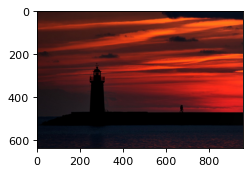

b13_red.jpg                       
Similarity             0.01       
- red mean            86.68       
- green mean          28.51       
- blue mean           24.68       


In [15]:
e1.searchForImage("exercise1/query/", "q4_white.jpg", euclideanSimilarity)

# ANSWERS:
# The query image is not completely white. It is actually grey, but human eye gets trapped.
# Euclidean similarity gives the distance between means so we should take a look on these values. Top images
# have close values to query image, but they are not so similar for human eye. First image that user may be 
# interested in is B20, which is on 7th place. Why? Look at high means, euclidean distance is high, so similarity
# is smaller.

# Exercise 2: Shapes + Centroid + Moment Invariants + Hu Moments

2.1) In Exercise 1 you have derived image properties based on its color. Apart from the color, one may analyse a shape of an object (objects) contained in the picture. The measures which account for this are called image moments. Via image moments one may derive, e.g, an area, a total intensity, or a centroid of an object. However, it is important to remember that a segmentation of the image must be performed first in order to extract objects from the image.
<br><br>
In this exercise you are asked to compute centroids of the red, green, and blue color components. Use center_of_mass() method. It returns a pair of values [row - y coordinate, column - x coordinate] for a given matrix. Run the script and analyse the results: <br>
    i) What is the difference between the centroid of the red color and the centroid of the blue color for image 3.jpg?<br>
   ii) Why are the centroids of the red and the blue color the same for images 4.jpg-6.jpg? <br>
   iii) Considering images 7.jpg-9.jpg, why is "red x" the greatest for the image 8.jpg and is the smallest for the image 9.jpg?

c:\users\kinkr\appdata\local\programs\python\python38-32\lib\site-packages\scipy\ndimage\measurements.py:1358: RuntimeWarning: invalid value encountered in double_scalars
  results = [sum(input * grids[dir].astype(float), labels, index) / normalizer


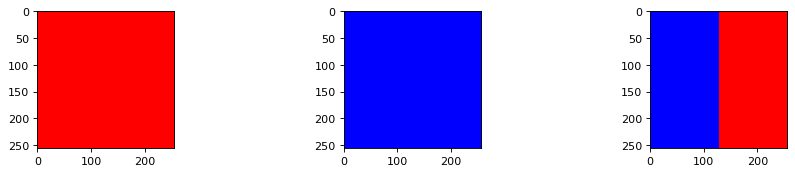

1.jpg                         2.jpg                         3.jpg                         
- red x            127.50     - red x               nan     - red x            191.50     
- red y            127.50     - red y               nan     - red y            127.50     
- green x             nan     - green x             nan     - green x             nan     
- green y             nan     - green y             nan     - green y             nan     
- blue x              nan     - blue x           127.50     - blue x            63.50     
- blue y              nan     - blue y           127.50     - blue y           127.50     


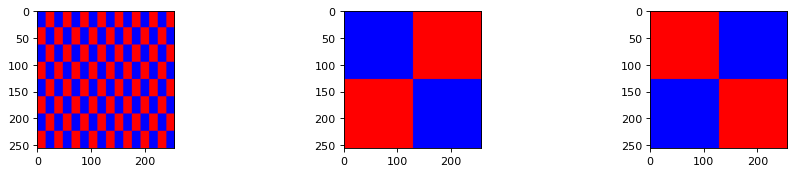

4.jpg                         5.jpg                         6.jpg                         
- red x            127.50     - red x            127.50     - red x            127.50     
- red y            127.50     - red y            127.50     - red y            127.50     
- green x             nan     - green x             nan     - green x             nan     
- green y             nan     - green y             nan     - green y             nan     
- blue x           127.50     - blue x           127.50     - blue x           127.50     
- blue y           127.50     - blue y           127.50     - blue y           127.50     


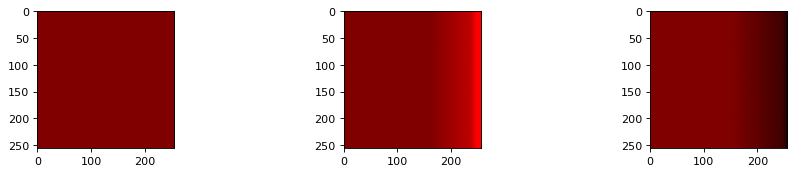

7.jpg                         8.jpg                         9.jpg                         
- red x            127.50     - red x            139.93     - red x            114.64     
- red y            127.50     - red y            127.50     - red y            127.50     
- green x             nan     - green x          210.14     - green x          204.96     
- green y             nan     - green y          126.53     - green y          127.69     
- blue x              nan     - blue x           197.74     - blue x           205.96     
- blue y              nan     - blue y           128.51     - blue y           127.46     


In [16]:
#centroid
featuresNames_CentroidColors = ["red x", "red y",
                 "green x", "green y",
                 "blue x", "blue y"]

# TODO: DONE
def featuresExtractor_CentroidColors(image):
    red = center_of_mass(image[:,:,0])
    green = center_of_mass(image[:,:,1])
    blue = center_of_mass(image[:,:,2])
    values = [
        red[1], red[0],
        green[1], green[0],
        blue[1], blue[0]
    ]
    return values
    
e2 = Exercise("exercise1/intro/", featuresNames_CentroidColors, featuresExtractor_CentroidColors)
e2.display(scale = 1.0)

# ANSWERS
# 1. y-coordinates of these two centroid are the same. As we can see both colours have the same localization taking\
# into account "y". We can see that blue is on the left-hand side of image and red is on right-hand side of image.
# The same we can tell reading x-coordinates of centroid - blue has 63.5, which is 1/4 of image width and
# red has 191,5 which is 3/4 width of image. These are centers of x-coordinate of blue and red shapes.

# 2. Both blue and red chuncks are "equally" located on the picture. Both colours take whole x and y axis so 
# centroid of this is exactly in the middle of x and y axis, which is 127.50.

# 3. 7.jpg is equally "red" across x. 8.jpg is brighter on right side and 9.jpg is darker on right side. And thats
# the reason why. The brighter red colour the higher red channel values are. So center of red colour goes
# to right. With darker pictures the situation is opposite on right side there are lower red channel values, so
# centroid of red colour is moved to left side.

2.2) Some properties of the image (object) which may be found via image moments are called invariants. Moment invariants are properties of the object which do not change with respect to some specific tranformations, e.g., a translation, a scale, or a rotation. Execute the below code. All of the displayed pictures contain the same object. Yet, the difference is that location, size, and orientation of this object is different from one picture to another.

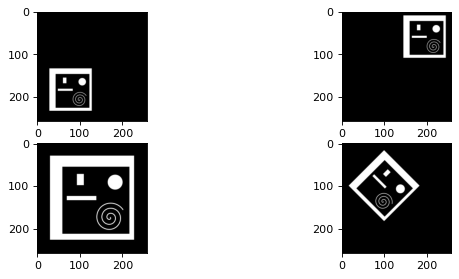

In [17]:
scale = 1.0
figure(figsize=(9.0 * scale, 4.0 * scale), dpi=80)
subplot(2, 2, 1); plt.imshow(io.imread("exercise2/base/hu1.jpg")) 
subplot(2, 2, 2); plt.imshow(io.imread("exercise2/base/hu2.jpg")) 
subplot(2, 2, 3); plt.imshow(io.imread("exercise2/base/hu3.jpg")) 
subplot(2, 2, 4); plt.imshow(io.imread("exercise2/base/hu4.jpg")) 
plt.show()

2.2) Hu moments is a vector of 7 values which are invariant (as a vector) with respect to translation, scale, and rotation. It means that Hu moments derived from the above images should be the same. In this Exercise you are asked to complete featuresExtractor_Hu method which has to return Hu moments for a given input image. As you may notice, this image is firstly converted to the grayscale and, later, the computed Hu moments are normalised (lambda function). To compute Hu Moments (hu = [ ]) you have to, step by step:<br>
1) Compute raw moments (method moments())<br>
2) Compute central moments (method moments_central())<br>
3) Compute normalized moments (method moments_normalised())<br>
4) Compute Hu moments (method moments_hu())<br>
See the documentation of the scikit package (module measure) for a detailed information about how to use the above methods.

In [18]:
norm = lambda x: -np.sign(x)*np.log10(np.abs(x))

featuresNames_Hu = ["hu1", "hu2", "hu3","hu4", "hu5", "hu6","hu7"]

# TODO: DONE, needs check
def featuresExtractor_Hu(image):
    img = rgb2gray(image)
    M = moments(img)
    centroid = (M[1, 0] / M[0, 0], M[0, 1] / M[0, 0])
    imgCentral = moments_central(img, centroid)
    imgNormalized = moments_normalized(imgCentral)
    hu = moments_hu(imgNormalized)
    l = [norm(f) for f in hu]
    return l
    
e2 = Exercise("exercise2/base/", featuresNames_Hu, featuresExtractor_Hu)

2.3) Search for the most similar images to q1.jpg. Verify the results (you can use the cosineSimilarity method). Why are some of the computed Hu moments different from one image to another (these images which contain the same object), while they should not?

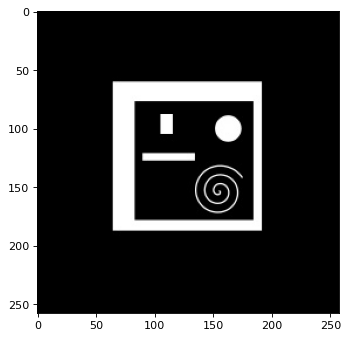

q1.jpg
- hu1                0.27     
- hu2                3.27     
- hu3                4.01     
- hu4                2.42     
- hu5               -5.82     
- hu6               -4.05     
- hu7               -5.74     


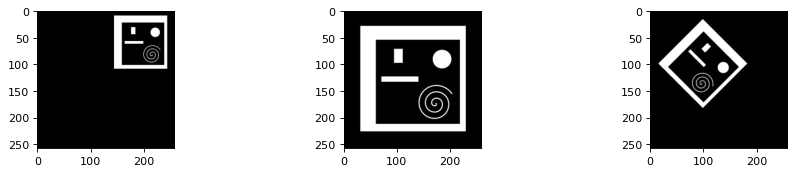

hu2.jpg                       hu3.jpg                       hu4.jpg                       
Similarity           1.00     Similarity           1.00     Similarity           1.00     
- hu1                0.27     - hu1                0.27     - hu1                0.27     
- hu2                3.28     - hu2                3.27     - hu2                3.27     
- hu3                4.01     - hu3                4.00     - hu3                4.01     
- hu4                2.42     - hu4                2.42     - hu4                2.42     
- hu5               -5.82     - hu5               -5.82     - hu5               -5.82     
- hu6               -4.06     - hu6               -4.06     - hu6               -4.05     
- hu7               -5.75     - hu7               -5.74     - hu7               -5.75     


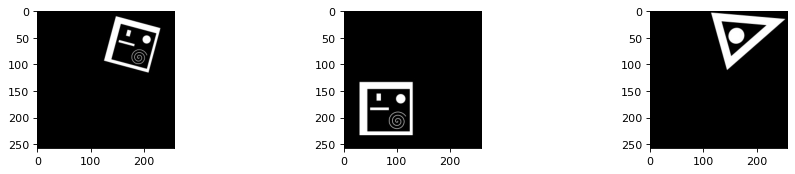

hu5.jpg                       hu1.jpg                       hu9.jpg                       
Similarity           1.00     Similarity           1.00     Similarity          -0.59     
- hu1                0.27     - hu1                0.27     - hu1                0.48     
- hu2                3.28     - hu2                3.28     - hu2                2.00     
- hu3                4.02     - hu3                4.01     - hu3                1.69     
- hu4                2.42     - hu4                2.42     - hu4                3.14     
- hu5               -5.83     - hu5               -5.82     - hu5                5.57     
- hu6               -4.06     - hu6               -4.06     - hu6                4.16     
- hu7               -5.75     - hu7               -5.76     - hu7                6.39     


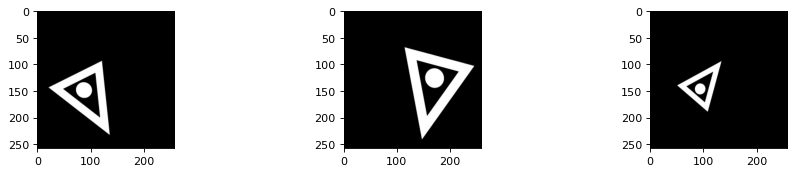

hu8.jpg                       hu6.jpg                       hu10.jpg                      
Similarity          -0.59     Similarity          -0.59     Similarity          -0.59     
- hu1                0.48     - hu1                0.48     - hu1                0.48     
- hu2                2.00     - hu2                2.00     - hu2                2.00     
- hu3                1.69     - hu3                1.69     - hu3                1.69     
- hu4                3.14     - hu4                3.14     - hu4                3.14     
- hu5                5.57     - hu5                5.56     - hu5                5.56     
- hu6                4.16     - hu6                4.16     - hu6                4.16     
- hu7                6.39     - hu7                6.40     - hu7                6.40     


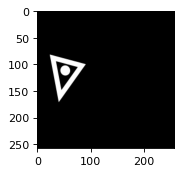

hu7.jpg                       
Similarity          -0.59     
- hu1                0.48     
- hu2                2.00     
- hu3                1.69     
- hu4                3.14     
- hu5                5.57     
- hu6                4.16     
- hu7                6.41     


In [19]:
e2.searchForImage("exercise2/query/", "q1.jpg", cosineSimilarity)

# ANSWERS
# Transformations like resizing or rotation on paper may seem perfect but in reality every operation on image makes
# that image slightly changes it's quality or single pixels relative location. As we can see hu moments values
# are not so different so we have to take into account minor errors.

2.4) Repeat the previous task for query = q2.jpg.

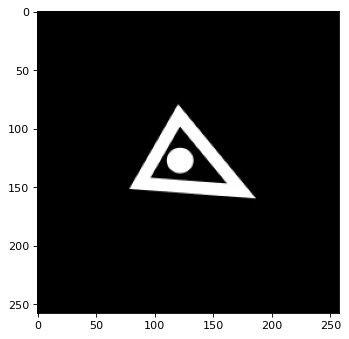

q2.jpg
- hu1                0.48     
- hu2                2.00     
- hu3                1.69     
- hu4                3.14     
- hu5                5.56     
- hu6                4.16     
- hu7                6.42     


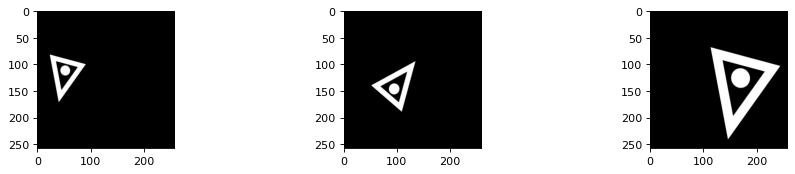

hu7.jpg                       hu10.jpg                      hu6.jpg                       
Similarity           1.00     Similarity           1.00     Similarity           1.00     
- hu1                0.48     - hu1                0.48     - hu1                0.48     
- hu2                2.00     - hu2                2.00     - hu2                2.00     
- hu3                1.69     - hu3                1.69     - hu3                1.69     
- hu4                3.14     - hu4                3.14     - hu4                3.14     
- hu5                5.57     - hu5                5.56     - hu5                5.56     
- hu6                4.16     - hu6                4.16     - hu6                4.16     
- hu7                6.41     - hu7                6.40     - hu7                6.40     


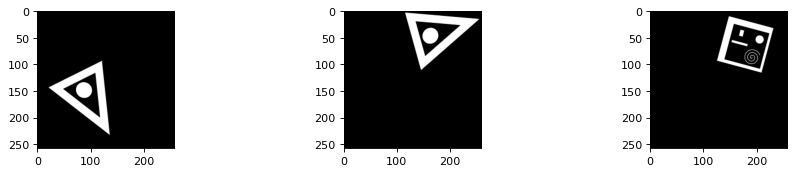

hu8.jpg                       hu9.jpg                       hu5.jpg                       
Similarity           1.00     Similarity           1.00     Similarity          -0.59     
- hu1                0.48     - hu1                0.48     - hu1                0.27     
- hu2                2.00     - hu2                2.00     - hu2                3.28     
- hu3                1.69     - hu3                1.69     - hu3                4.02     
- hu4                3.14     - hu4                3.14     - hu4                2.42     
- hu5                5.57     - hu5                5.57     - hu5               -5.83     
- hu6                4.16     - hu6                4.16     - hu6               -4.06     
- hu7                6.39     - hu7                6.39     - hu7               -5.75     


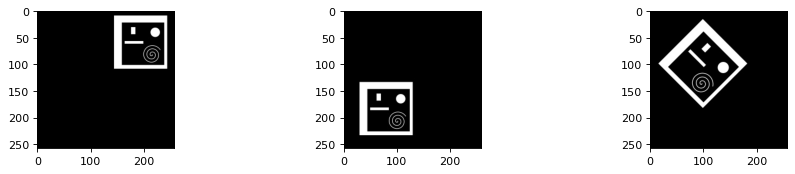

hu2.jpg                       hu1.jpg                       hu4.jpg                       
Similarity          -0.59     Similarity          -0.59     Similarity          -0.59     
- hu1                0.27     - hu1                0.27     - hu1                0.27     
- hu2                3.28     - hu2                3.28     - hu2                3.27     
- hu3                4.01     - hu3                4.01     - hu3                4.01     
- hu4                2.42     - hu4                2.42     - hu4                2.42     
- hu5               -5.82     - hu5               -5.82     - hu5               -5.82     
- hu6               -4.06     - hu6               -4.06     - hu6               -4.05     
- hu7               -5.75     - hu7               -5.76     - hu7               -5.75     


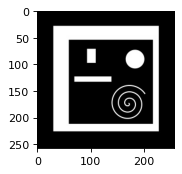

hu3.jpg                       
Similarity          -0.59     
- hu1                0.27     
- hu2                3.27     
- hu3                4.00     
- hu4                2.42     
- hu5               -5.82     
- hu6               -4.06     
- hu7               -5.74     


In [20]:
e2.searchForImage("exercise2/query/", "q2.jpg", cosineSimilarity)

#ANSWERS
# It's the same situation as before. Hu moments values are not so different from each other taking into account
# one image. Reasons why this happens is the same as previous one - rescaling, resizing causes quality losses.

# Exercise 3: Texture + Gabor's Filter

3.1) Apart from the color and the shape, a texture is an important characteristic of an object/image. Run the below code. In this Exercise you are asked to implement simple search engine based on Gabor's filter. Gabor's filter is a linear filter used for texture analysis. It can be applied to an image to detect specyfic frequency content (pattern). This involves different frequencies as well as the sizes of this content. Gabor's filter is a Gaussian kernel function modulated by a sinusoidal wave. Look at the below figures. They illustrate several Gabor's filters which are different with repect to the orientation (angle) and the frequency. You may change the values of angles and freqs arrays and run the script again to see the results. However, restore their original values for the remainder of this exercise. 

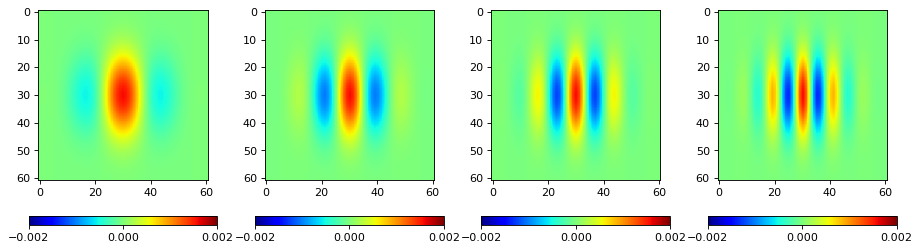

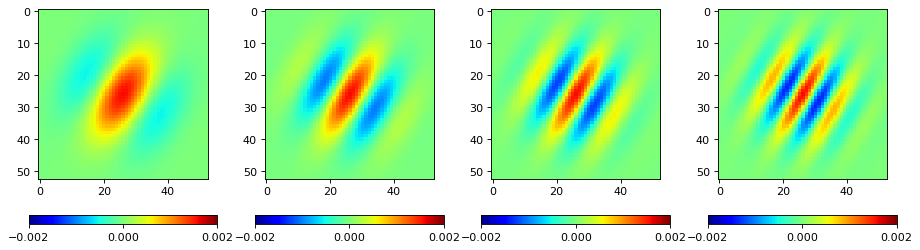

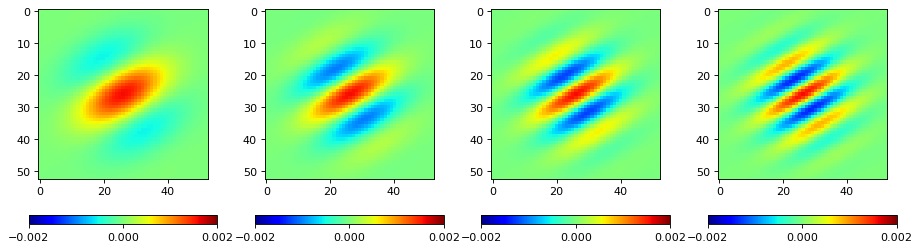

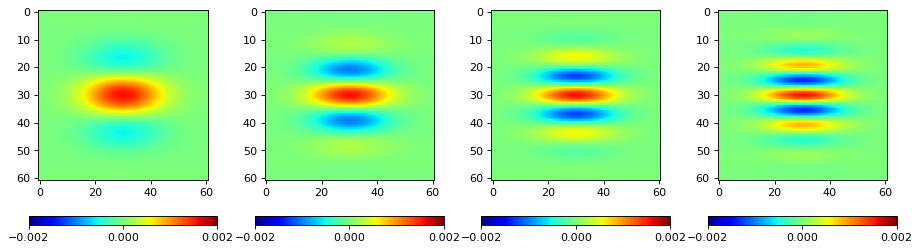

In [21]:
std = 10.0

#angles = [0, 30, 60, 90]
#freqs = [0.03, 0.05, 0.07, 0.09]
angles = [0, 30, 60, 90]
freqs = [0.03, 0.05, 0.07, 0.09]

scale = 1.0
kernels = []

for angle in angles:
    kernels_row = []
    figure(figsize=(14.0 * scale, 4.0 * scale), dpi=80)
    num = 0
    for freq in freqs:
        num += 1
        kernel = np.real(gabor_kernel(freq, theta=angle / 90.0 * 0.5 * np.pi, sigma_x=std, sigma_y=std))
        kernels_row.append(kernel)
        subplot(1, 4, num); plt.imshow(kernel, cmap='jet', vmin=-0.002, vmax=0.002) 
        plt.colorbar(orientation='horizontal', ticks = [-0.002, 0.0, 0.002])
    kernels.append(kernels_row)
plt.show()

3.2) The above filters (kernels) are convolved with the original picture. The obtained results of the convolution are images which represents frequency contant (size, orientation, frequency) which appears in the original image. Run the below script (ignore the last image):<br><br>
i) The image b1.jpg illustrates a zebra. Do you see the pattern? <br> 
ii) The below pictures are the results of the convolution. Compare them with the previously (above) illustrated Gabor's filters (kernels). Why is the outcome of the convolution the most visible for the kernels with the lowest frequencies (0.03, 0.05) and for the kernels with the lowest angles (0.0, 30.0)? <br> 
iii) Change b1.jpg to b10.jpg. Why is the outcome equally visible for all of the considered angles? <br>

There are many ways to incorporate Gabor's filters to image recognition. Usually, feature vectors are derived directly from the outomes of the convolution and the machine learning is involved to build a prediction model. In this exercise, you are asked to use a very simple apporach rather than the machine learning. Your task is to aggregate the outcomes of the convolution in order to generate a single image which represents frequency content detected in the original image. For that purpose, complete the three TODOs in the below code such that an averaged outcome of the img_convolve outcomes is generated. Run the script again and the the results (last image).

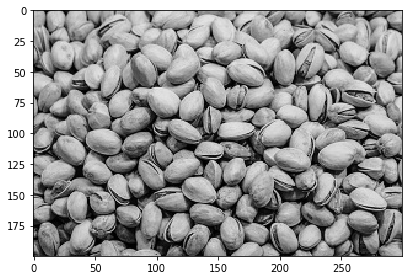

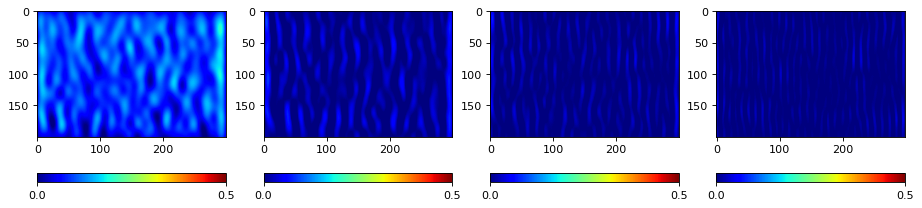

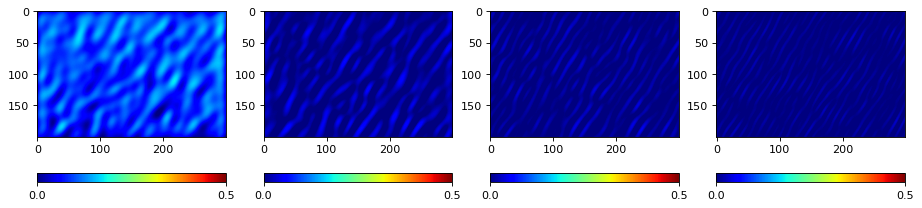

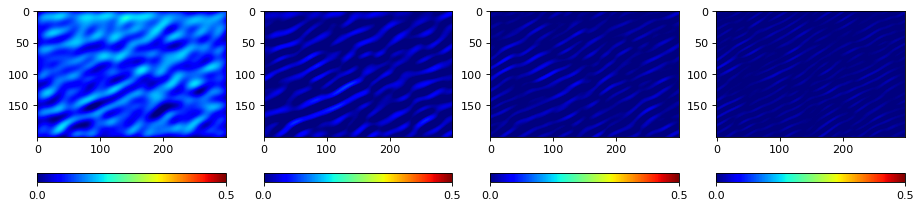

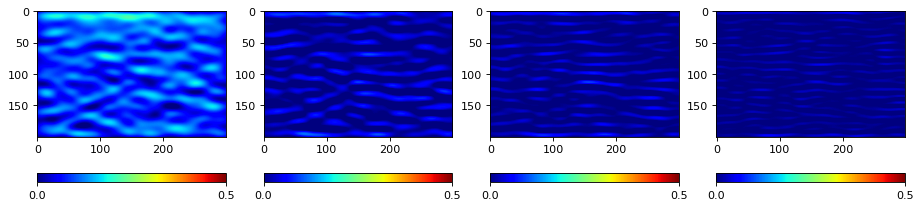

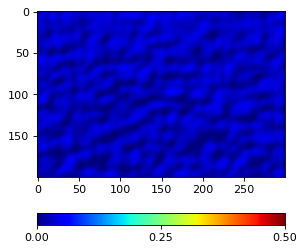

In [22]:
image = rgb2gray(io.imread("exercise3/base/b10.jpg"))
io.imshow(image)

# TODO: init sum_image with zeros (np. zero). The matrix must be of a proper size (image.shape)
# DONE
sum_image = np.zeros(image.shape)

for row in kernels:
    figure(figsize=(14.0 * scale, 4.0 * scale), dpi=80)
    num = 0
    for kernel in row:
        num += 1
        img_convolve = fftconvolve(image, kernel, mode='same')  
    
        # TODO: DONE
        # add img_convovle to sum_image
        sum_image += img_convolve
        
        subplot(1, 4, num); plt.imshow(img_convolve, cmap='jet', vmin=0.0, vmax=0.5) 
        plt.colorbar(orientation='horizontal', ticks=[0.0, 0.5])
        
# TODO compute the averaged values (divide sum_image by the number of kernels = 16)
# DONE
averaged_image = sum_image / 16

plt.show()
figure(figsize=(4.0 * scale, 4.0 * scale), dpi=80)
subplot(1, 1, 1); plt.imshow(averaged_image, cmap='jet', vmin=0.0, vmax=0.5) 
plt.colorbar(orientation='horizontal', ticks=[0.0, 0.25, 0.5])
plt.show()

# ANSWERS:
# 1. Yes, the pattern can be seen very well. The frequency seems constant.

# 2. If we speak about angle it's good to compare first picture for angle 0 (a) and first picture for angle 30 (b).
# First two zebra's stripes are vertically located and these are the brightest in picture a and not so bright on
# picture b. But if look at the rest of stripes, which are at greater angle (about 30 degrees), these are the
# brightest on picture b but dimmed on picture a. So the reason why outcome is most visible for 0 and 30 degrees
# is because of position of zebra's stripes.
# Similar situation is with frequency. Zebra's stripes are let's say equally apart from each other. So with
# frequencies 0.03 and 0.05 we successfully found these distances between stripes. As we can see, higher frequency
# values cause results to dim. It's because these frequencies have too big width so that the cannot "spot" the stripe.

# 3. Because the image doesn't represent any typical pattern, so the outcome won't change, depending on the angle.
# That means that at every angle filter can find some kind of pattern which is invisible for human eye.

# AFTER TODOs:
# For the b1 image, the results are very pure. The pattern is strengthened and can be seen easily.
# But for the b10 image, the results are very blurred and it's actually difficult to compare it to the original image.

3.3) Complete the applyGaborsFilters method such that it returns an averaged image (outcomes of convolution; you can just copy the code you finished in the previous step).

In [23]:
# TODO: DONE
def applyGaborsFilters(image):
    image = rgb2gray(image)
    sum_image = np.zeros(image.shape)

    for row in kernels:
        #figure(figsize=(14.0 * scale, 4.0 * scale), dpi=80)
        num = 0
        for kernel in row:
            num += 1
            img_convolve = fftconvolve(image, kernel, mode='same')  

            #subplot(1, 4, num); plt.imshow(img_convolve, cmap='jet', vmin=0.0, vmax=0.5) 
            #plt.colorbar(orientation='horizontal', ticks=[0.0, 0.5])

            sum_image += img_convolve
    return sum_image / 16

3.4) Run the below script and analyse the results of applyGaborsFilters() method for different images. Consider the images with the stripes and these without the stripes (grain). These are the two textures which are considered in this exercise. What measure (mean, std, e.t.) may give different results for these two textures and may be used as a measure of similarity?

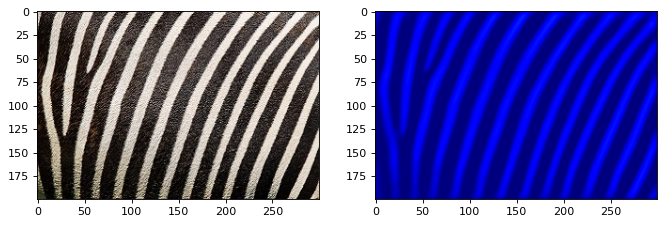

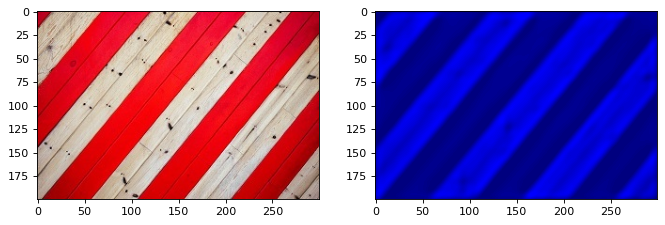

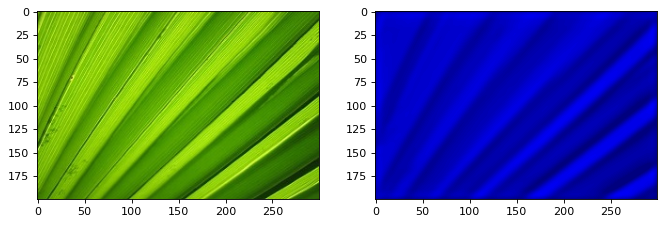

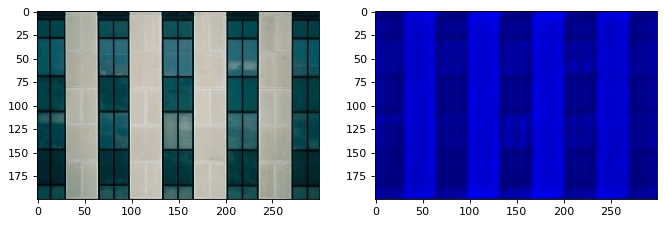

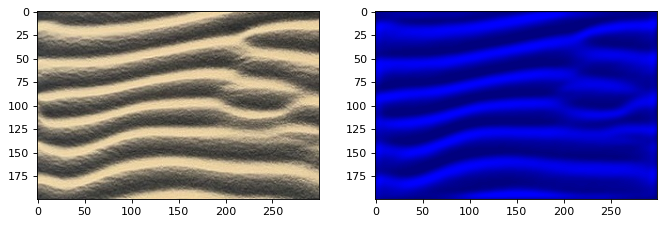

...

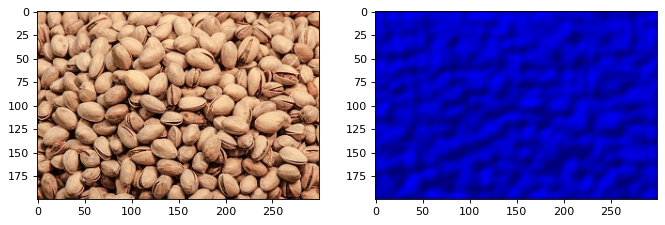

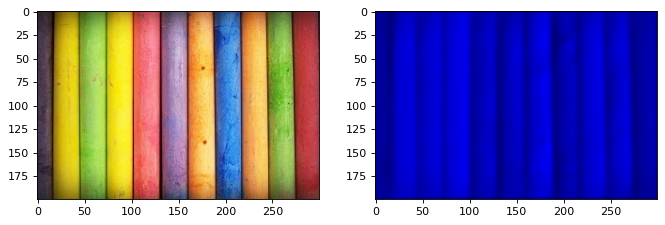

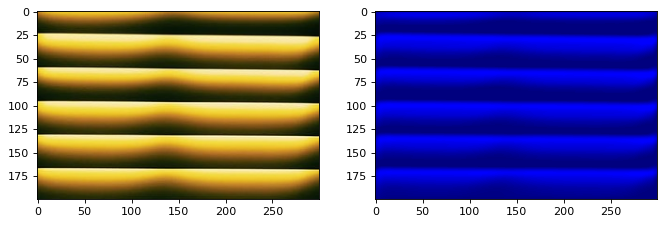

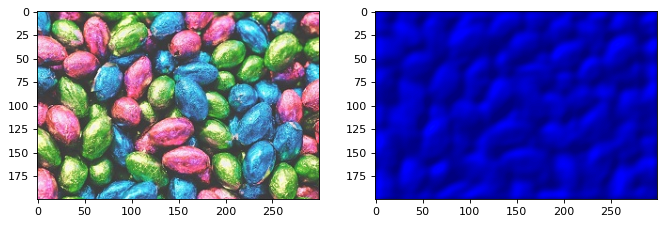

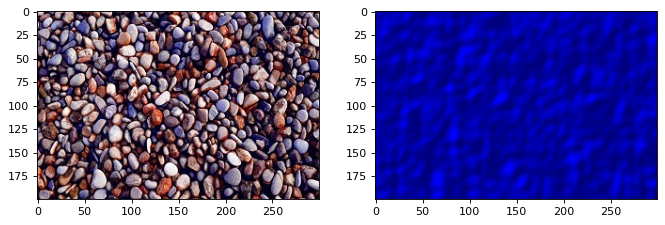

In [24]:
def displayGabors():
    scale = 1.0
    collection1 = io.imread_collection("exercise3/base/*.jpg") 
    collection2 = io.imread_collection("exercise3/query/*.jpg")  
    images1 = [collection1[i] for i in range(0, len(collection1))]
    images2 = [collection2[i] for i in range(0, len(collection2))]
    images = images1 + images2
    for image in images:
        figure(figsize=(10.0 * scale, 5.0 * scale), dpi=80)
        gabor_image = applyGaborsFilters(image)
        subplot(1, 2, 1); plt.imshow(image) 
        subplot(1, 2, 2); plt.imshow(gabor_image, cmap='jet', vmin=0.0, vmax=0.5)
        plt.show()
displayGabors()

# ANSWERS
# Skewness won't be good measure, because there is measures asymmetry of distribution. And as we can see,
# these pictures don't represent any visible distribution of colours no matter if it's grain or stripes.
# Even worse is mean. As we look at these convultions even we can say "average" colour of the pictures and it's the
# same for grain and stripes.
# We threw away skewness measure so we have to do the same with kurtosis, because they are very similar.
# If we think about standard deviation it can be good measure. Probably it's high for stripes, because there
# are two the same areas - stripe and not-stripe, which are different for each other. And it will be low for
# grain - there are many areas which are not so different for each other. So difference between extreme pixel values
# and mean won't be so dramatic.

3.5) In this exercise you are asked to make a simple search engine for finding images based on the texture. For this purpose:<br><br>
i) Complete the featuresExtractor_Texture method. Firstly, it should use applyGaborsFilters method to generate an anverge outcome of the convolution for 16 Gabor's filters which were previously generated. Then, the method should return a feature vector consisting of the mean, the standard deviation, the skeweness, and the kurtosis of values of the generated image. The kurtosis is a fourth color moment and it measures how flat (or tall) the distribution is in comparison to normal distribution.   <br>
ii) Complete the weightedSumSimilarity method. It should compute a weighted sum of the absolute values of the differences between the values of the subsequent characteristics (features). Remember that the smaller is that sum the greater is the similarity but the method expects that with the greater similarity the greater is the outcome.  <br>
<br>
Run the below four scripts and analyse the results. Do you find them satisfactory? Which feature accounts for measuring similarity the most? Try to manipulate the weights in order to improve the results.

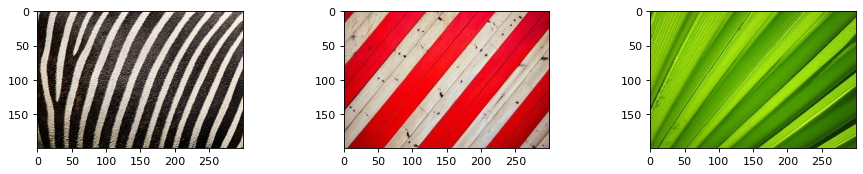

b1.jpg                        b2.jpg                        b3.jpg                        
- Mean             103.59     - Mean             135.24     - Mean              91.59     
- Std               85.06     - Std               90.38     - Std               72.92     
- Skew               0.40     - Skew              -0.48     - Skew               0.18     
- Kurt              -1.45     - Kurt              -1.50     - Kurt              -1.28     


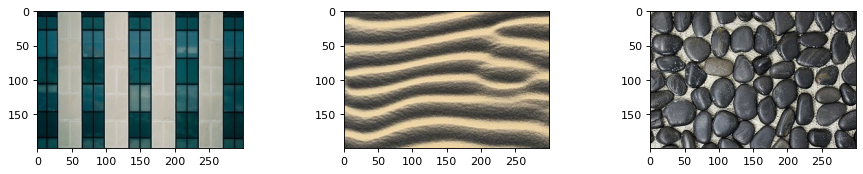

b4.jpg                        b5.jpg                        b6.jpg                        
- Mean             111.43     - Mean             126.53     - Mean              88.94     
- Std               71.63     - Std               56.51     - Std               52.55     
- Skew              -0.13     - Skew               0.47     - Skew               0.97     
- Kurt              -1.54     - Kurt              -1.02     - Kurt               0.45     


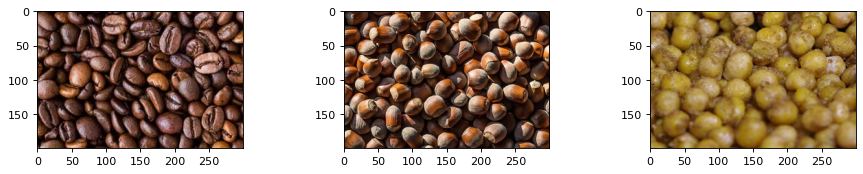

b7.jpg                        b8.jpg                        b9.jpg                        
- Mean              69.41     - Mean              74.46     - Mean             105.14     
- Std               56.04     - Std               65.19     - Std               53.62     
- Skew               0.72     - Skew               0.97     - Skew              -0.17     
- Kurt              -0.35     - Kurt              -0.10     - Kurt              -1.07     


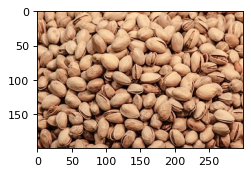

b10.jpg                       
- Mean             135.80     
- Std               66.73     
- Skew              -0.35     
- Kurt              -0.76     


In [25]:
featuresNames_Texture = ["Mean", "Std", "Skew","Kurt"]

# TODO: DONE
def featuresExtractor_Texture(image):
    img = applyGaborsFilters(image)
    img = image
    imgMean = np.mean(img)
    imgStd = np.std(img)
    imgSkew = skew(img.ravel())
    imgKurt = kurtosis(img.ravel())
    return [imgMean, imgStd, imgSkew, imgKurt]

# TODO: DONE
def weightedSumSimilarity(featuresQuery, featuresImage):
    weights = [0.3, 0.4, 0.1, 0.2]
    values = [abs(q-i) for q, i in zip(featuresQuery, featuresImage)]
    score = [w * v for w, v in zip(weights, values)]
    return 1 / (1 + sum(score))

e3 = Exercise("exercise3/base/", featuresNames_Texture, featuresExtractor_Texture)
e3.display()

# ANSWERS
# The best measure for similarity is std, because it's different for stripes and for grain
# However results are not satisfactiory. Let's consider b5.jpg, it's probably sand. It has very low std, and high
# mean. Every other stripes have higher std. And look at b10, it has very high mean, other grains have lower means.
# It's hard to get good results for these measures.
# Take a look at the last example. Compare values in q4 and b3, they are almost the same.

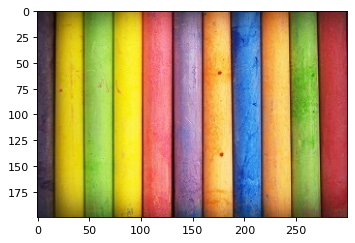

q1.jpg
- Mean             129.30     
- Std               70.44     
- Skew               0.14     
- Kurt              -1.16     


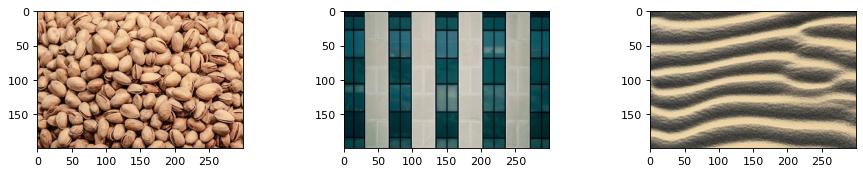

b10.jpg                       b4.jpg                        b5.jpg                        
Similarity           0.22     Similarity           0.14     Similarity           0.13     
- Mean             135.80     - Mean             111.43     - Mean             126.53     
- Std               66.73     - Std               71.63     - Std               56.51     
- Skew              -0.35     - Skew              -0.13     - Skew               0.47     
- Kurt              -0.76     - Kurt              -1.54     - Kurt              -1.02     


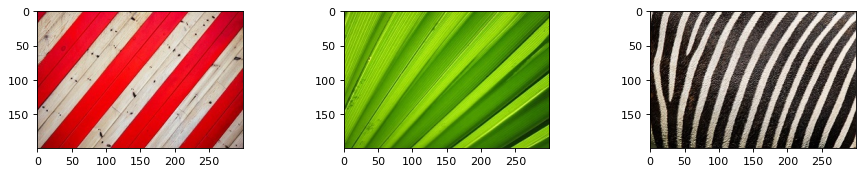

b2.jpg                        b3.jpg                        b1.jpg                        
Similarity           0.09     Similarity           0.07     Similarity           0.07     
- Mean             135.24     - Mean              91.59     - Mean             103.59     
- Std               90.38     - Std               72.92     - Std               85.06     
- Skew              -0.48     - Skew               0.18     - Skew               0.40     
- Kurt              -1.50     - Kurt              -1.28     - Kurt              -1.45     


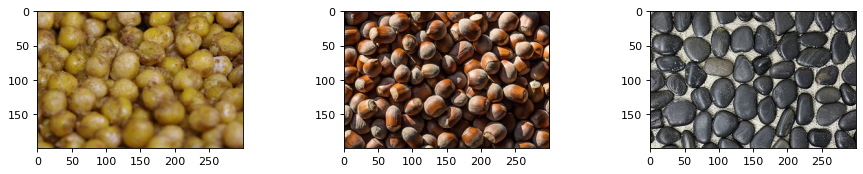

b9.jpg                        b8.jpg                        b6.jpg                        
Similarity           0.07     Similarity           0.05     Similarity           0.05     
- Mean             105.14     - Mean              74.46     - Mean              88.94     
- Std               53.62     - Std               65.19     - Std               52.55     
- Skew              -0.17     - Skew               0.97     - Skew               0.97     
- Kurt              -1.07     - Kurt              -0.10     - Kurt               0.45     


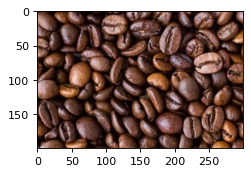

b7.jpg                        
Similarity           0.04     
- Mean              69.41     
- Std               56.04     
- Skew               0.72     
- Kurt              -0.35     


In [26]:
e3.searchForImage("exercise3/query/", "q1.jpg", weightedSumSimilarity)

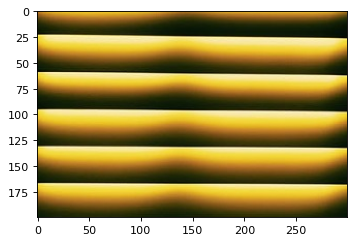

q2.jpg
- Mean             104.01     
- Std               83.47     
- Skew               0.48     
- Kurt              -1.28     


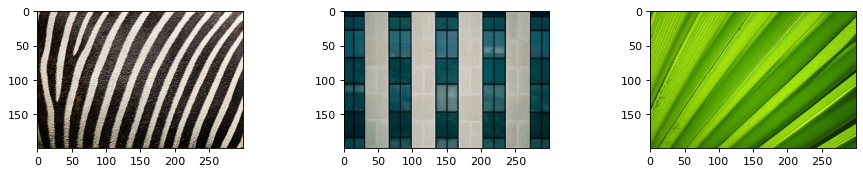

b1.jpg                        b4.jpg                        b3.jpg                        
Similarity           0.56     Similarity           0.12     Similarity           0.11     
- Mean             103.59     - Mean             111.43     - Mean              91.59     
- Std               85.06     - Std               71.63     - Std               72.92     
- Skew               0.40     - Skew              -0.13     - Skew               0.18     
- Kurt              -1.45     - Kurt              -1.54     - Kurt              -1.28     


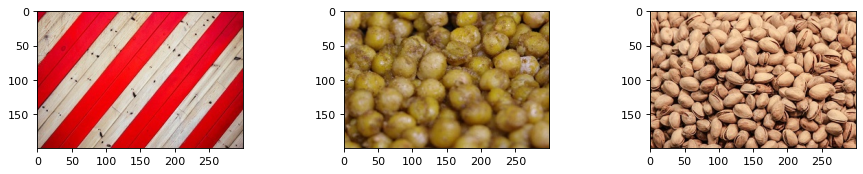

b2.jpg                        b9.jpg                        b10.jpg                       
Similarity           0.08     Similarity           0.07     Similarity           0.06     
- Mean             135.24     - Mean             105.14     - Mean             135.80     
- Std               90.38     - Std               53.62     - Std               66.73     
- Skew              -0.48     - Skew              -0.17     - Skew              -0.35     
- Kurt              -1.50     - Kurt              -1.07     - Kurt              -0.76     


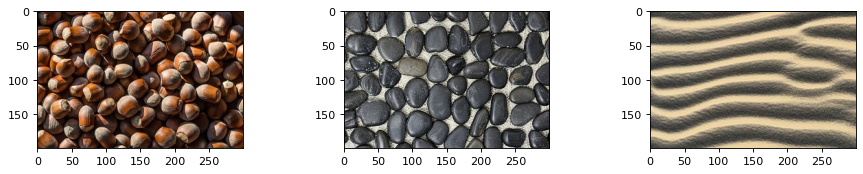

b8.jpg                        b6.jpg                        b5.jpg                        
Similarity           0.06     Similarity           0.05     Similarity           0.05     
- Mean              74.46     - Mean              88.94     - Mean             126.53     
- Std               65.19     - Std               52.55     - Std               56.51     
- Skew               0.97     - Skew               0.97     - Skew               0.47     
- Kurt              -0.10     - Kurt               0.45     - Kurt              -1.02     


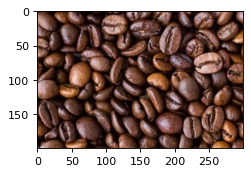

b7.jpg                        
Similarity           0.04     
- Mean              69.41     
- Std               56.04     
- Skew               0.72     
- Kurt              -0.35     


In [27]:
e3.searchForImage("exercise3/query/", "q2.jpg", weightedSumSimilarity)

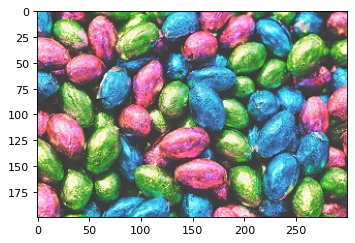

q3.jpg
- Mean             126.46     
- Std               63.98     
- Skew               0.52     
- Kurt              -1.05     


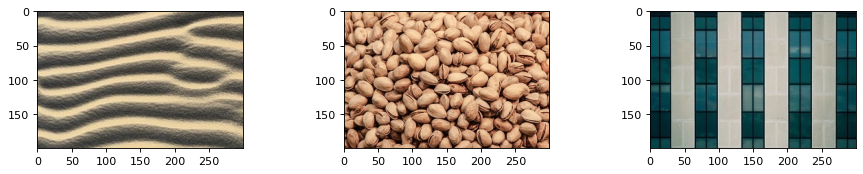

b5.jpg                        b10.jpg                       b4.jpg                        
Similarity           0.25     Similarity           0.20     Similarity           0.11     
- Mean             126.53     - Mean             135.80     - Mean             111.43     
- Std               56.51     - Std               66.73     - Std               71.63     
- Skew               0.47     - Skew              -0.35     - Skew              -0.13     
- Kurt              -1.02     - Kurt              -0.76     - Kurt              -1.54     


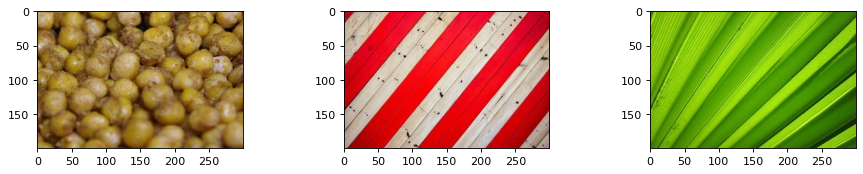

b9.jpg                        b2.jpg                        b3.jpg                        
Similarity           0.09     Similarity           0.07     Similarity           0.07     
- Mean             105.14     - Mean             135.24     - Mean              91.59     
- Std               53.62     - Std               90.38     - Std               72.92     
- Skew              -0.17     - Skew              -0.48     - Skew               0.18     
- Kurt              -1.07     - Kurt              -1.50     - Kurt              -1.28     


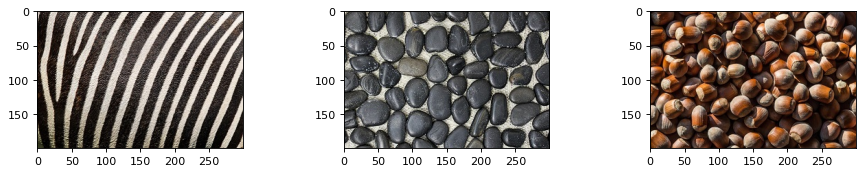

b1.jpg                        b6.jpg                        b8.jpg                        
Similarity           0.06     Similarity           0.06     Similarity           0.06     
- Mean             103.59     - Mean              88.94     - Mean              74.46     
- Std               85.06     - Std               52.55     - Std               65.19     
- Skew               0.40     - Skew               0.97     - Skew               0.97     
- Kurt              -1.45     - Kurt               0.45     - Kurt              -0.10     


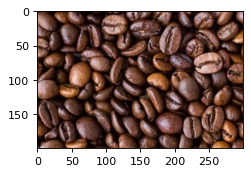

b7.jpg                        
Similarity           0.05     
- Mean              69.41     
- Std               56.04     
- Skew               0.72     
- Kurt              -0.35     


In [28]:
e3.searchForImage("exercise3/query/", "q3.jpg", weightedSumSimilarity)

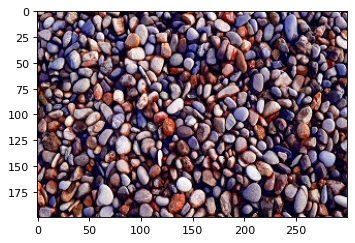

q4.jpg
- Mean              92.19     
- Std               72.13     
- Skew               0.41     
- Kurt              -1.06     


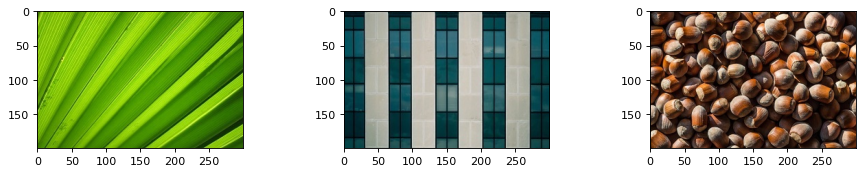

b3.jpg                        b4.jpg                        b8.jpg                        
Similarity           0.64     Similarity           0.14     Similarity           0.11     
- Mean              91.59     - Mean             111.43     - Mean              74.46     
- Std               72.92     - Std               71.63     - Std               65.19     
- Skew               0.18     - Skew              -0.13     - Skew               0.97     
- Kurt              -1.28     - Kurt              -1.54     - Kurt              -0.10     


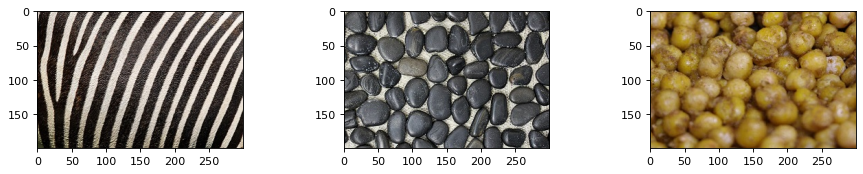

b1.jpg                        b6.jpg                        b9.jpg                        
Similarity           0.10     Similarity           0.10     Similarity           0.08     
- Mean             103.59     - Mean              88.94     - Mean             105.14     
- Std               85.06     - Std               52.55     - Std               53.62     
- Skew               0.40     - Skew               0.97     - Skew              -0.17     
- Kurt              -1.45     - Kurt               0.45     - Kurt              -1.07     


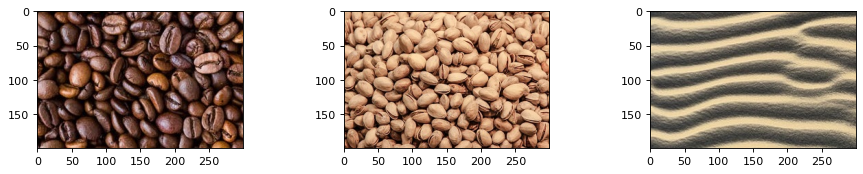

b7.jpg                        b10.jpg                       b5.jpg                        
Similarity           0.07     Similarity           0.06     Similarity           0.06     
- Mean              69.41     - Mean             135.80     - Mean             126.53     
- Std               56.04     - Std               66.73     - Std               56.51     
- Skew               0.72     - Skew              -0.35     - Skew               0.47     
- Kurt              -0.35     - Kurt              -0.76     - Kurt              -1.02     


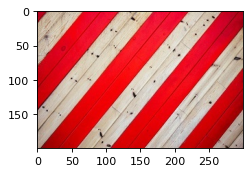

b2.jpg                        
Similarity           0.05     
- Mean             135.24     
- Std               90.38     
- Skew              -0.48     
- Kurt              -1.50     


In [29]:
e3.searchForImage("exercise3/query/", "q4.jpg", weightedSumSimilarity)